In [28]:

import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd 
import random 
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader,random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
from torchvision.utils import save_image

2023-03-27 18:01:42.695868: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-27 18:01:43.384689: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-03-27 18:01:53.379801: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda-11.0/lib64:/usr/local/cuda-11.0/targets/x86_64-linux/lib//usr/local/cud

In [29]:
device = ""
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

In [30]:
logging.basicConfig(format="%(asctime)s - %(levelname)s: %(message)s",level=logging.INFO,datefmt="%I:%M:%S")

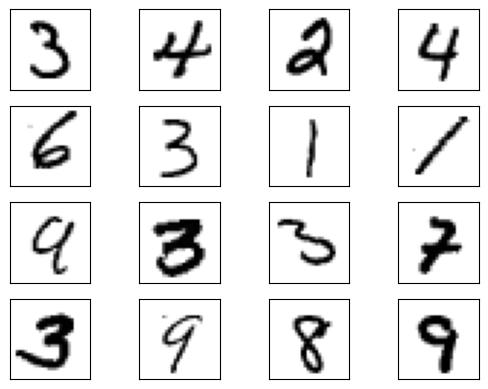

In [6]:
transform = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))]
)
train_dataset = torchvision.datasets.MNIST(
    root=".", train=True, download=True, transform=transform
)
test_dataset = torchvision.datasets.MNIST(
    root=".", train=True, download=True, transform=transform
)
batch_size = 32
train_loader = torch.utils.data.DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True
)
real_samples, mnist_labels = next(iter(train_loader))
for i in range(16):
    ax = plt.subplot(4, 4, i + 1)
    plt.imshow(real_samples[i].reshape(28, 28), cmap="gray_r")
    plt.xticks([])
    plt.yticks([])

In [44]:
train_transform = transforms.Compose([
transforms.ToTensor(),
])

test_transform = transforms.Compose([
transforms.ToTensor(),
])


In [7]:
train_dataset.transform = transform
test_dataset.transform = transform

In [8]:
m=len(train_dataset)

train_data, val_data = random_split(train_dataset, [int(m-m*0.2), int(m*0.2)])
batch_size=32

train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size)
valid_loader = torch.utils.data.DataLoader(val_data, batch_size=batch_size)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size,shuffle=True)

In [10]:
class VariationalEncoder(nn.Module):
    def __init__(self, latent_dims):  
        super(VariationalEncoder, self).__init__()
        self.conv1 = nn.Conv2d(1, 8, 3, stride=2, padding=1)
        self.conv2 = nn.Conv2d(8, 16, 3, stride=2, padding=1)
        self.batch2 = nn.BatchNorm2d(16)
        self.conv3 = nn.Conv2d(16, 32, 3, stride=2, padding=0)  
        self.linear1 = nn.Linear(3*3*32, 128)
        self.linear2 = nn.Linear(128, latent_dims)
        self.linear3 = nn.Linear(128, latent_dims)

        self.N = torch.distributions.Normal(0, 1)
        self.N.loc = self.N.loc.cuda() # hack to get sampling on the GPU
        self.N.scale = self.N.scale.cuda()
        self.kl = 0

    def forward(self, x):
        x = x.to(device)
        x = F.relu(self.conv1(x))
        x = F.relu(self.batch2(self.conv2(x)))
        x = F.relu(self.conv3(x))
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.linear1(x))
        mu =  self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma*self.N.sample(mu.shape)
        self.kl = (sigma**2 + mu**2 - torch.log(sigma) - 1/2).sum()
        return z      

In [11]:
class Decoder(nn.Module):
    
    def __init__(self, latent_dims):
        super().__init__()

        self.decoder_lin = nn.Sequential(
            nn.Linear(latent_dims, 128),
            nn.ReLU(True),
            nn.Linear(128, 3 * 3 * 32),
            nn.ReLU(True)
        )

        self.unflatten = nn.Unflatten(dim=1, unflattened_size=(32, 3, 3))

        self.decoder_conv = nn.Sequential(
            nn.ConvTranspose2d(32, 16, 3, stride=2, output_padding=0),
            nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 1, 3, stride=2, padding=1, output_padding=1)
        )
        
    def forward(self, x):
        x = self.decoder_lin(x)
        x = self.unflatten(x)
        x = self.decoder_conv(x)
        x = torch.sigmoid(x)
        return x

In [12]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder(latent_dims)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        x = x.to(device)
        z = self.encoder(x)
        return self.decoder(z)

In [13]:

### Set the random seed for reproducible results
torch.manual_seed(0)

d = 4

vae = VariationalAutoencoder(latent_dims=d)

lr = 1e-3 

optim = torch.optim.Adam(vae.parameters(), lr=lr, weight_decay=1e-5)

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

vae.to(device)

Selected device: cuda


VariationalAutoencoder(
  (encoder): VariationalEncoder(
    (conv1): Conv2d(1, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (conv2): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (batch2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2))
    (linear1): Linear(in_features=288, out_features=128, bias=True)
    (linear2): Linear(in_features=128, out_features=4, bias=True)
    (linear3): Linear(in_features=128, out_features=4, bias=True)
  )
  (decoder): Decoder(
    (decoder_lin): Sequential(
      (0): Linear(in_features=4, out_features=128, bias=True)
      (1): ReLU(inplace=True)
      (2): Linear(in_features=128, out_features=288, bias=True)
      (3): ReLU(inplace=True)
    )
    (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
    (decoder_conv): Sequential(
      (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
      (1): BatchN

In [14]:
def train_epoch(vae, device, dataloader, optimizer):
    # Set train mode for both the encoder and the decoder
    vae.train()
    train_loss = 0.0
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for x, _ in dataloader: 
        # Move tensor to the proper device
        x = x.to(device)
        x_hat = vae(x)
        # Evaluate loss
        loss = ((x - x_hat)**2).sum() + vae.encoder.kl

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        print('\t partial train loss (single batch): %f' % (loss.item()))
        train_loss+=loss.item()

    return train_loss / len(dataloader.dataset)

In [15]:
def test_epoch(vae, device, dataloader):
    # Set evaluation mode for encoder and decoder
    vae.eval()
    val_loss = 0.0
    with torch.no_grad(): # No need to track the gradients
        for x, _ in dataloader:
            # Move tensor to the proper device
            x = x.to(device)
            # Encode data
            encoded_data = vae.encoder(x)
            # Decode data
            x_hat = vae(x)
            loss = ((x - x_hat)**2).sum() + vae.encoder.kl
            val_loss += loss.item()

    return val_loss / len(dataloader.dataset)

In [16]:
def plot_ae_outputs(encoder,decoder,n=10,counter=0):
    plt.figure(figsize=(16,4.5))
    targets = test_dataset.targets.numpy()
    t_idx = {i:np.where(targets==i)[0][0] for i in range(n)}
    for i in range(n):
      ax = plt.subplot(2,n,i+1)
      img = test_dataset[t_idx[i]][0].unsqueeze(0).to(device)
      encoder.eval()
      decoder.eval()
      with torch.no_grad():
         rec_img  = decoder(encoder(img))
      plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)  
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(2, n, i + 1 + n)
      plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')  
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)  
      if i == n//2:
         ax.set_title('Reconstructed images')
    plt.show()  
    plt.savefig('./samples/sample_vae' +str(counter)+ '.png')

	 partial train loss (single batch): 22408.843750
	 partial train loss (single batch): 22677.332031
	 partial train loss (single batch): 22603.451172
	 partial train loss (single batch): 22422.576172
	 partial train loss (single batch): 22538.974609
	 partial train loss (single batch): 22574.259766
	 partial train loss (single batch): 22481.041016
	 partial train loss (single batch): 22527.857422
	 partial train loss (single batch): 22494.105469
	 partial train loss (single batch): 22414.449219
	 partial train loss (single batch): 22438.232422
	 partial train loss (single batch): 22539.173828
	 partial train loss (single batch): 22546.691406
	 partial train loss (single batch): 22487.955078
	 partial train loss (single batch): 22608.728516
	 partial train loss (single batch): 22282.142578
	 partial train loss (single batch): 22827.050781
	 partial train loss (single batch): 22400.162109
	 partial train loss (single batch): 22452.919922
	 partial train loss (single batch): 22225.439453


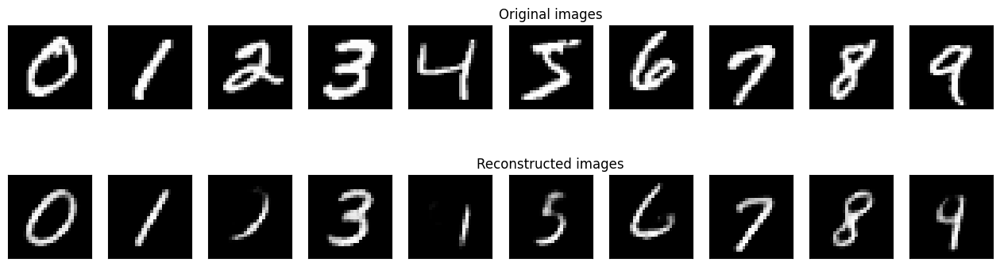

	 partial train loss (single batch): 22416.113281
	 partial train loss (single batch): 22673.109375
	 partial train loss (single batch): 22613.279297
	 partial train loss (single batch): 22484.341797
	 partial train loss (single batch): 22500.320312
	 partial train loss (single batch): 22545.925781
	 partial train loss (single batch): 22457.015625
	 partial train loss (single batch): 22510.423828
	 partial train loss (single batch): 22524.679688
	 partial train loss (single batch): 22401.162109
	 partial train loss (single batch): 22412.556641
	 partial train loss (single batch): 22556.140625
	 partial train loss (single batch): 22495.138672
	 partial train loss (single batch): 22487.753906
	 partial train loss (single batch): 22584.570312
	 partial train loss (single batch): 22243.191406
	 partial train loss (single batch): 22778.873047
	 partial train loss (single batch): 22375.544922
	 partial train loss (single batch): 22459.380859
	 partial train loss (single batch): 22182.503906


<Figure size 640x480 with 0 Axes>

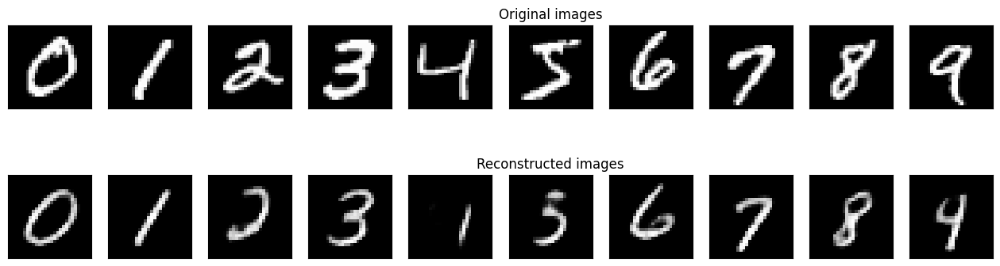

	 partial train loss (single batch): 22436.224609
	 partial train loss (single batch): 22665.632812
	 partial train loss (single batch): 22579.871094
	 partial train loss (single batch): 22448.138672
	 partial train loss (single batch): 22510.982422
	 partial train loss (single batch): 22548.478516
	 partial train loss (single batch): 22506.824219
	 partial train loss (single batch): 22477.935547
	 partial train loss (single batch): 22479.138672
	 partial train loss (single batch): 22397.343750
	 partial train loss (single batch): 22388.974609
	 partial train loss (single batch): 22552.933594
	 partial train loss (single batch): 22523.832031
	 partial train loss (single batch): 22491.966797
	 partial train loss (single batch): 22557.289062
	 partial train loss (single batch): 22238.394531
	 partial train loss (single batch): 22747.933594
	 partial train loss (single batch): 22363.332031
	 partial train loss (single batch): 22463.177734
	 partial train loss (single batch): 22212.755859


<Figure size 640x480 with 0 Axes>

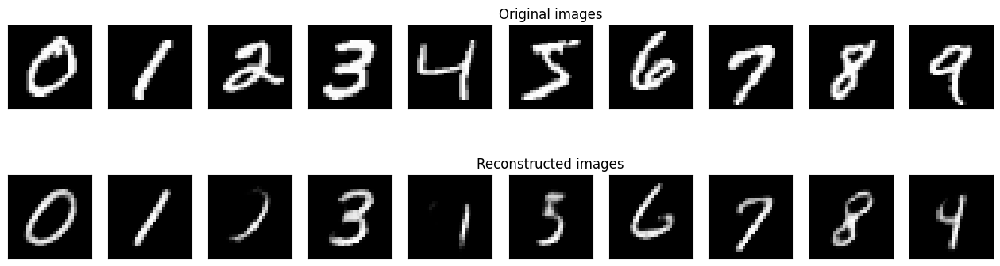

	 partial train loss (single batch): 22448.650391
	 partial train loss (single batch): 22632.333984
	 partial train loss (single batch): 22573.519531
	 partial train loss (single batch): 22440.687500
	 partial train loss (single batch): 22489.058594
	 partial train loss (single batch): 22537.416016
	 partial train loss (single batch): 22435.183594
	 partial train loss (single batch): 22491.818359
	 partial train loss (single batch): 22464.287109
	 partial train loss (single batch): 22360.347656
	 partial train loss (single batch): 22440.824219
	 partial train loss (single batch): 22567.193359
	 partial train loss (single batch): 22470.236328
	 partial train loss (single batch): 22438.439453
	 partial train loss (single batch): 22560.875000
	 partial train loss (single batch): 22246.921875
	 partial train loss (single batch): 22766.892578
	 partial train loss (single batch): 22386.585938
	 partial train loss (single batch): 22467.445312
	 partial train loss (single batch): 22216.701172


<Figure size 640x480 with 0 Axes>

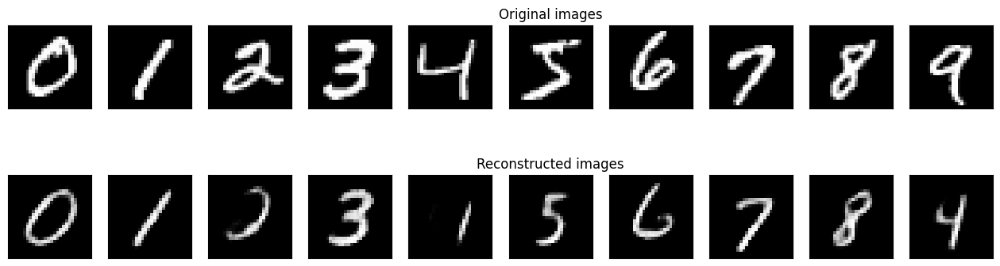

	 partial train loss (single batch): 22435.722656
	 partial train loss (single batch): 22660.359375
	 partial train loss (single batch): 22555.814453
	 partial train loss (single batch): 22410.927734
	 partial train loss (single batch): 22491.576172
	 partial train loss (single batch): 22534.419922
	 partial train loss (single batch): 22433.794922
	 partial train loss (single batch): 22456.060547
	 partial train loss (single batch): 22450.986328
	 partial train loss (single batch): 22357.621094
	 partial train loss (single batch): 22424.378906
	 partial train loss (single batch): 22521.294922
	 partial train loss (single batch): 22483.246094
	 partial train loss (single batch): 22433.736328
	 partial train loss (single batch): 22562.488281
	 partial train loss (single batch): 22218.464844
	 partial train loss (single batch): 22769.595703
	 partial train loss (single batch): 22385.882812
	 partial train loss (single batch): 22421.550781
	 partial train loss (single batch): 22181.503906


<Figure size 640x480 with 0 Axes>

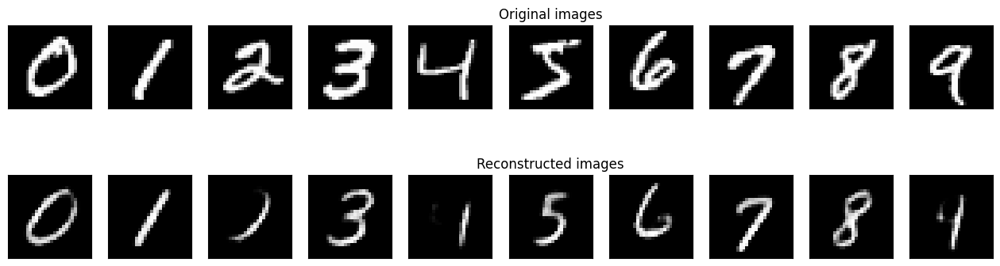

	 partial train loss (single batch): 22404.230469
	 partial train loss (single batch): 22647.408203
	 partial train loss (single batch): 22528.691406
	 partial train loss (single batch): 22399.322266
	 partial train loss (single batch): 22503.501953
	 partial train loss (single batch): 22529.000000
	 partial train loss (single batch): 22451.822266
	 partial train loss (single batch): 22433.494141
	 partial train loss (single batch): 22484.541016
	 partial train loss (single batch): 22351.324219
	 partial train loss (single batch): 22400.160156
	 partial train loss (single batch): 22523.597656
	 partial train loss (single batch): 22492.224609
	 partial train loss (single batch): 22453.277344
	 partial train loss (single batch): 22531.992188
	 partial train loss (single batch): 22255.044922
	 partial train loss (single batch): 22781.517578
	 partial train loss (single batch): 22368.005859
	 partial train loss (single batch): 22427.041016
	 partial train loss (single batch): 22204.472656


<Figure size 640x480 with 0 Axes>

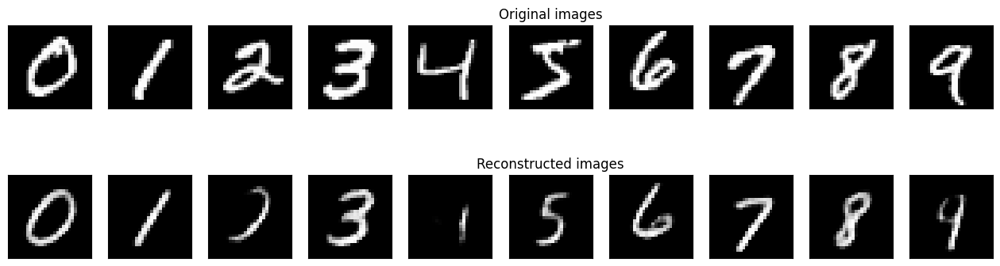

	 partial train loss (single batch): 22441.859375
	 partial train loss (single batch): 22637.601562
	 partial train loss (single batch): 22558.154297
	 partial train loss (single batch): 22400.857422
	 partial train loss (single batch): 22466.277344
	 partial train loss (single batch): 22494.408203
	 partial train loss (single batch): 22465.240234
	 partial train loss (single batch): 22429.580078
	 partial train loss (single batch): 22441.406250
	 partial train loss (single batch): 22357.525391
	 partial train loss (single batch): 22398.300781
	 partial train loss (single batch): 22501.191406
	 partial train loss (single batch): 22472.460938
	 partial train loss (single batch): 22435.853516
	 partial train loss (single batch): 22568.378906
	 partial train loss (single batch): 22233.458984
	 partial train loss (single batch): 22767.605469
	 partial train loss (single batch): 22348.406250
	 partial train loss (single batch): 22465.814453
	 partial train loss (single batch): 22200.011719


<Figure size 640x480 with 0 Axes>

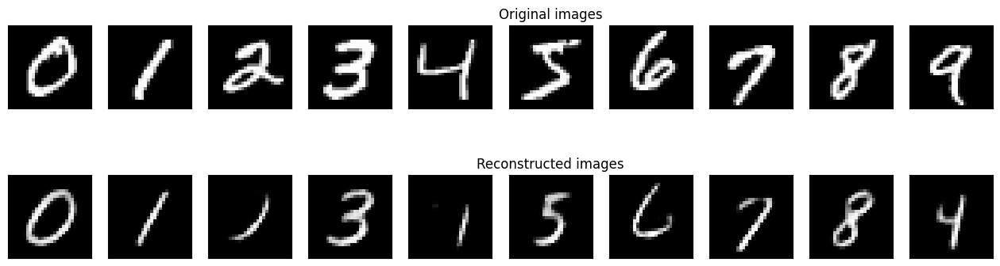

	 partial train loss (single batch): 22402.878906
	 partial train loss (single batch): 22625.167969
	 partial train loss (single batch): 22552.697266
	 partial train loss (single batch): 22424.763672
	 partial train loss (single batch): 22462.902344
	 partial train loss (single batch): 22536.042969
	 partial train loss (single batch): 22458.287109
	 partial train loss (single batch): 22412.791016
	 partial train loss (single batch): 22435.216797
	 partial train loss (single batch): 22368.455078
	 partial train loss (single batch): 22381.775391
	 partial train loss (single batch): 22528.244141
	 partial train loss (single batch): 22453.371094
	 partial train loss (single batch): 22485.546875
	 partial train loss (single batch): 22511.632812
	 partial train loss (single batch): 22202.285156
	 partial train loss (single batch): 22723.197266
	 partial train loss (single batch): 22355.392578
	 partial train loss (single batch): 22433.707031
	 partial train loss (single batch): 22168.546875


<Figure size 640x480 with 0 Axes>

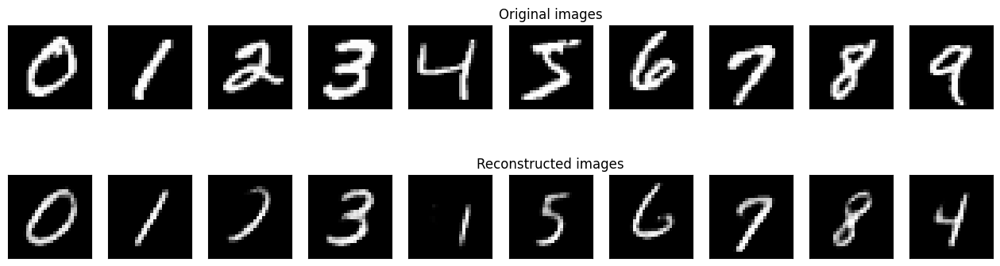

	 partial train loss (single batch): 22385.027344
	 partial train loss (single batch): 22633.250000
	 partial train loss (single batch): 22548.935547
	 partial train loss (single batch): 22421.199219
	 partial train loss (single batch): 22475.460938
	 partial train loss (single batch): 22547.695312
	 partial train loss (single batch): 22464.697266
	 partial train loss (single batch): 22466.429688
	 partial train loss (single batch): 22424.009766
	 partial train loss (single batch): 22338.544922
	 partial train loss (single batch): 22384.007812
	 partial train loss (single batch): 22518.880859
	 partial train loss (single batch): 22468.646484
	 partial train loss (single batch): 22444.837891
	 partial train loss (single batch): 22548.781250
	 partial train loss (single batch): 22209.001953
	 partial train loss (single batch): 22742.457031
	 partial train loss (single batch): 22356.218750
	 partial train loss (single batch): 22430.025391
	 partial train loss (single batch): 22156.855469


<Figure size 640x480 with 0 Axes>

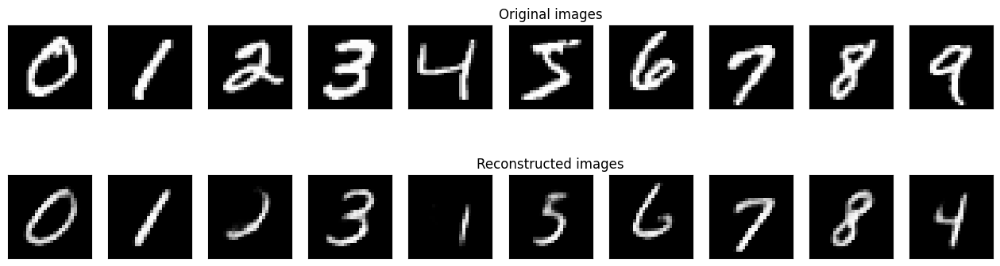

	 partial train loss (single batch): 22434.189453
	 partial train loss (single batch): 22644.634766
	 partial train loss (single batch): 22521.308594
	 partial train loss (single batch): 22400.642578
	 partial train loss (single batch): 22460.085938
	 partial train loss (single batch): 22507.218750
	 partial train loss (single batch): 22442.298828
	 partial train loss (single batch): 22415.169922
	 partial train loss (single batch): 22466.130859
	 partial train loss (single batch): 22356.886719
	 partial train loss (single batch): 22382.175781
	 partial train loss (single batch): 22522.550781
	 partial train loss (single batch): 22432.306641
	 partial train loss (single batch): 22452.728516
	 partial train loss (single batch): 22568.199219
	 partial train loss (single batch): 22191.103516
	 partial train loss (single batch): 22722.546875
	 partial train loss (single batch): 22381.982422
	 partial train loss (single batch): 22432.640625
	 partial train loss (single batch): 22175.978516


<Figure size 640x480 with 0 Axes>

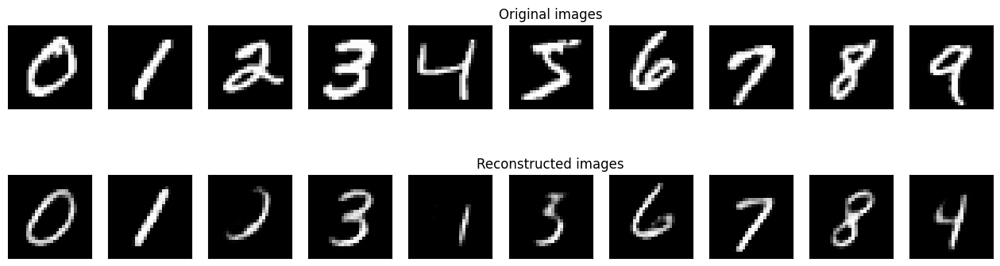

	 partial train loss (single batch): 22416.507812
	 partial train loss (single batch): 22647.546875
	 partial train loss (single batch): 22534.632812
	 partial train loss (single batch): 22430.283203
	 partial train loss (single batch): 22422.541016
	 partial train loss (single batch): 22505.642578
	 partial train loss (single batch): 22433.906250
	 partial train loss (single batch): 22379.029297
	 partial train loss (single batch): 22440.818359
	 partial train loss (single batch): 22367.171875
	 partial train loss (single batch): 22383.871094
	 partial train loss (single batch): 22497.007812
	 partial train loss (single batch): 22444.642578
	 partial train loss (single batch): 22447.021484
	 partial train loss (single batch): 22543.353516
	 partial train loss (single batch): 22171.880859
	 partial train loss (single batch): 22753.683594
	 partial train loss (single batch): 22355.238281
	 partial train loss (single batch): 22414.500000
	 partial train loss (single batch): 22192.769531


<Figure size 640x480 with 0 Axes>

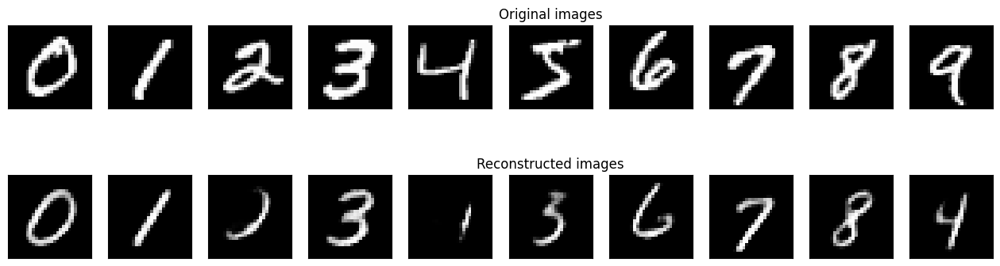

	 partial train loss (single batch): 22403.568359
	 partial train loss (single batch): 22601.832031
	 partial train loss (single batch): 22534.500000
	 partial train loss (single batch): 22401.142578
	 partial train loss (single batch): 22454.878906
	 partial train loss (single batch): 22555.564453
	 partial train loss (single batch): 22432.263672
	 partial train loss (single batch): 22405.228516
	 partial train loss (single batch): 22454.013672
	 partial train loss (single batch): 22367.117188
	 partial train loss (single batch): 22411.804688
	 partial train loss (single batch): 22516.287109
	 partial train loss (single batch): 22436.152344
	 partial train loss (single batch): 22466.667969
	 partial train loss (single batch): 22554.570312
	 partial train loss (single batch): 22188.105469
	 partial train loss (single batch): 22777.048828
	 partial train loss (single batch): 22342.363281
	 partial train loss (single batch): 22422.515625
	 partial train loss (single batch): 22166.509766


<Figure size 640x480 with 0 Axes>

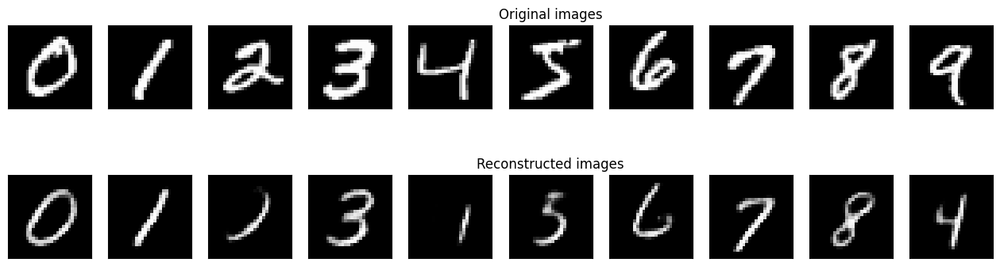

	 partial train loss (single batch): 22408.998047
	 partial train loss (single batch): 22634.683594
	 partial train loss (single batch): 22504.058594
	 partial train loss (single batch): 22379.351562
	 partial train loss (single batch): 22440.275391
	 partial train loss (single batch): 22537.103516
	 partial train loss (single batch): 22414.775391
	 partial train loss (single batch): 22397.011719
	 partial train loss (single batch): 22405.150391
	 partial train loss (single batch): 22347.267578
	 partial train loss (single batch): 22398.357422
	 partial train loss (single batch): 22494.914062
	 partial train loss (single batch): 22390.173828
	 partial train loss (single batch): 22463.994141
	 partial train loss (single batch): 22555.595703
	 partial train loss (single batch): 22150.351562
	 partial train loss (single batch): 22732.146484
	 partial train loss (single batch): 22333.529297
	 partial train loss (single batch): 22424.652344
	 partial train loss (single batch): 22136.824219


<Figure size 640x480 with 0 Axes>

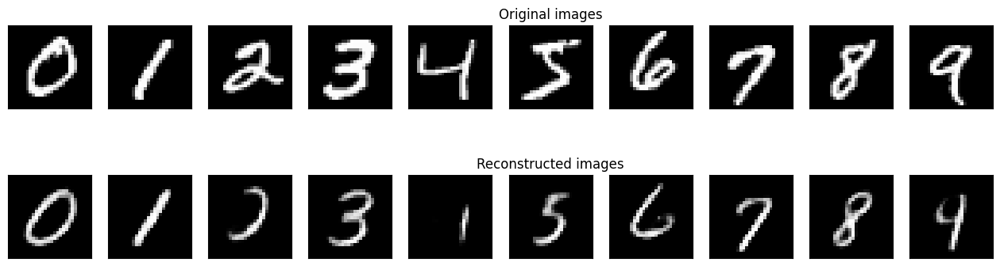

	 partial train loss (single batch): 22407.898438
	 partial train loss (single batch): 22632.107422
	 partial train loss (single batch): 22510.597656
	 partial train loss (single batch): 22384.431641
	 partial train loss (single batch): 22465.857422
	 partial train loss (single batch): 22542.544922
	 partial train loss (single batch): 22421.779297
	 partial train loss (single batch): 22426.246094
	 partial train loss (single batch): 22401.669922
	 partial train loss (single batch): 22354.105469
	 partial train loss (single batch): 22360.365234
	 partial train loss (single batch): 22501.652344
	 partial train loss (single batch): 22419.144531
	 partial train loss (single batch): 22413.117188
	 partial train loss (single batch): 22507.777344
	 partial train loss (single batch): 22176.183594
	 partial train loss (single batch): 22724.144531
	 partial train loss (single batch): 22359.314453
	 partial train loss (single batch): 22417.947266
	 partial train loss (single batch): 22148.759766


<Figure size 640x480 with 0 Axes>

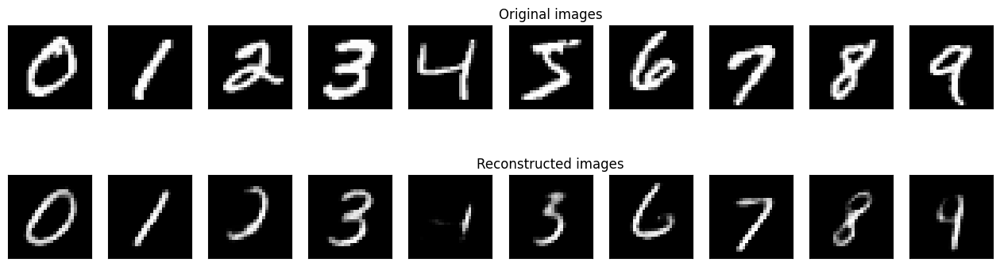

	 partial train loss (single batch): 22408.437500
	 partial train loss (single batch): 22620.029297
	 partial train loss (single batch): 22528.058594
	 partial train loss (single batch): 22419.187500
	 partial train loss (single batch): 22466.091797
	 partial train loss (single batch): 22534.929688
	 partial train loss (single batch): 22455.576172
	 partial train loss (single batch): 22421.835938
	 partial train loss (single batch): 22384.535156
	 partial train loss (single batch): 22364.111328
	 partial train loss (single batch): 22368.964844
	 partial train loss (single batch): 22481.703125
	 partial train loss (single batch): 22406.287109
	 partial train loss (single batch): 22433.720703
	 partial train loss (single batch): 22494.187500
	 partial train loss (single batch): 22174.103516
	 partial train loss (single batch): 22728.224609
	 partial train loss (single batch): 22354.210938
	 partial train loss (single batch): 22411.375000
	 partial train loss (single batch): 22120.962891


<Figure size 640x480 with 0 Axes>

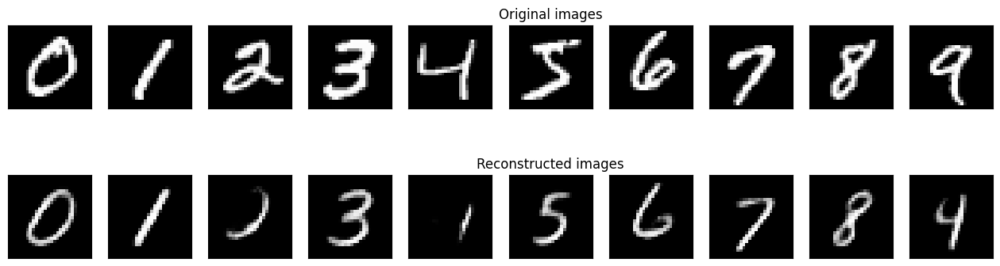

	 partial train loss (single batch): 22383.757812
	 partial train loss (single batch): 22615.628906
	 partial train loss (single batch): 22541.328125
	 partial train loss (single batch): 22395.576172
	 partial train loss (single batch): 22431.837891
	 partial train loss (single batch): 22539.814453
	 partial train loss (single batch): 22447.537109
	 partial train loss (single batch): 22417.541016
	 partial train loss (single batch): 22431.621094
	 partial train loss (single batch): 22367.871094
	 partial train loss (single batch): 22382.068359
	 partial train loss (single batch): 22478.240234
	 partial train loss (single batch): 22422.685547
	 partial train loss (single batch): 22452.177734
	 partial train loss (single batch): 22498.927734
	 partial train loss (single batch): 22174.693359
	 partial train loss (single batch): 22771.287109
	 partial train loss (single batch): 22332.617188
	 partial train loss (single batch): 22389.238281
	 partial train loss (single batch): 22125.103516


<Figure size 640x480 with 0 Axes>

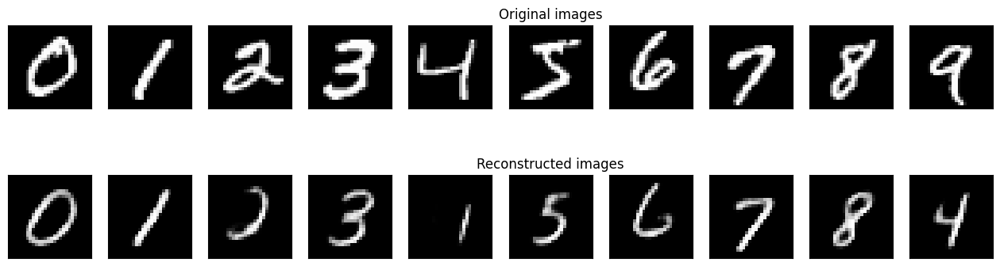

	 partial train loss (single batch): 22387.015625
	 partial train loss (single batch): 22618.187500
	 partial train loss (single batch): 22530.087891
	 partial train loss (single batch): 22400.578125
	 partial train loss (single batch): 22450.900391
	 partial train loss (single batch): 22515.304688
	 partial train loss (single batch): 22434.482422
	 partial train loss (single batch): 22431.025391
	 partial train loss (single batch): 22403.601562
	 partial train loss (single batch): 22318.691406
	 partial train loss (single batch): 22365.683594
	 partial train loss (single batch): 22484.750000
	 partial train loss (single batch): 22456.917969
	 partial train loss (single batch): 22468.371094
	 partial train loss (single batch): 22560.843750
	 partial train loss (single batch): 22194.638672
	 partial train loss (single batch): 22749.083984
	 partial train loss (single batch): 22338.634766
	 partial train loss (single batch): 22424.423828
	 partial train loss (single batch): 22115.296875


<Figure size 640x480 with 0 Axes>

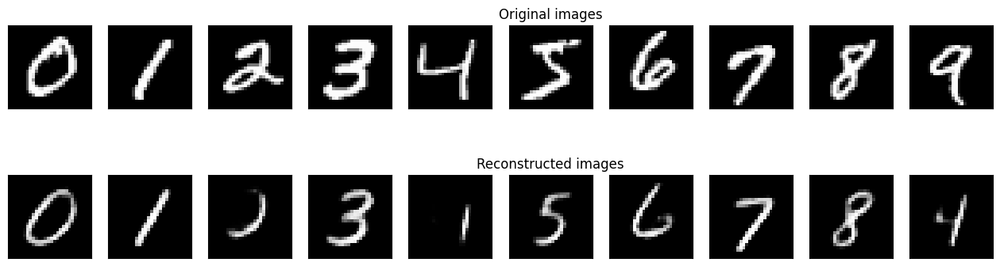

	 partial train loss (single batch): 22391.791016
	 partial train loss (single batch): 22597.269531
	 partial train loss (single batch): 22533.335938
	 partial train loss (single batch): 22405.314453
	 partial train loss (single batch): 22484.042969
	 partial train loss (single batch): 22544.769531
	 partial train loss (single batch): 22434.902344
	 partial train loss (single batch): 22431.250000
	 partial train loss (single batch): 22384.837891
	 partial train loss (single batch): 22330.324219
	 partial train loss (single batch): 22354.064453
	 partial train loss (single batch): 22493.882812
	 partial train loss (single batch): 22431.697266
	 partial train loss (single batch): 22461.902344
	 partial train loss (single batch): 22516.757812
	 partial train loss (single batch): 22180.080078
	 partial train loss (single batch): 22738.785156
	 partial train loss (single batch): 22328.671875
	 partial train loss (single batch): 22407.146484
	 partial train loss (single batch): 22131.833984


<Figure size 640x480 with 0 Axes>

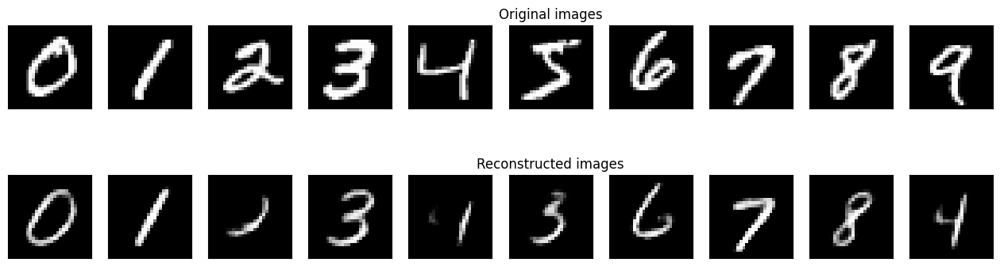

	 partial train loss (single batch): 22365.941406
	 partial train loss (single batch): 22623.833984
	 partial train loss (single batch): 22527.019531
	 partial train loss (single batch): 22406.990234
	 partial train loss (single batch): 22459.078125
	 partial train loss (single batch): 22535.324219
	 partial train loss (single batch): 22429.263672
	 partial train loss (single batch): 22382.482422
	 partial train loss (single batch): 22384.558594
	 partial train loss (single batch): 22307.019531
	 partial train loss (single batch): 22360.447266
	 partial train loss (single batch): 22460.525391
	 partial train loss (single batch): 22392.945312
	 partial train loss (single batch): 22420.238281
	 partial train loss (single batch): 22527.076172
	 partial train loss (single batch): 22174.535156
	 partial train loss (single batch): 22731.632812
	 partial train loss (single batch): 22319.865234
	 partial train loss (single batch): 22418.611328
	 partial train loss (single batch): 22145.050781


<Figure size 640x480 with 0 Axes>

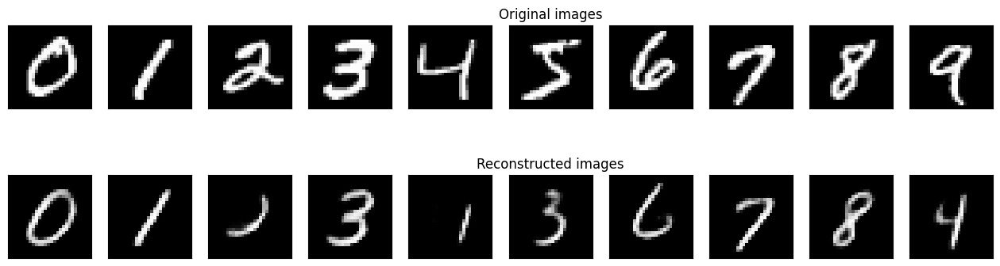

	 partial train loss (single batch): 22370.367188
	 partial train loss (single batch): 22633.626953
	 partial train loss (single batch): 22490.232422
	 partial train loss (single batch): 22369.527344
	 partial train loss (single batch): 22451.619141
	 partial train loss (single batch): 22545.384766
	 partial train loss (single batch): 22464.455078
	 partial train loss (single batch): 22425.824219
	 partial train loss (single batch): 22377.960938
	 partial train loss (single batch): 22307.392578
	 partial train loss (single batch): 22363.593750
	 partial train loss (single batch): 22489.257812
	 partial train loss (single batch): 22406.169922
	 partial train loss (single batch): 22407.757812
	 partial train loss (single batch): 22537.791016
	 partial train loss (single batch): 22154.720703
	 partial train loss (single batch): 22735.585938
	 partial train loss (single batch): 22336.195312
	 partial train loss (single batch): 22396.292969
	 partial train loss (single batch): 22100.544922


<Figure size 640x480 with 0 Axes>

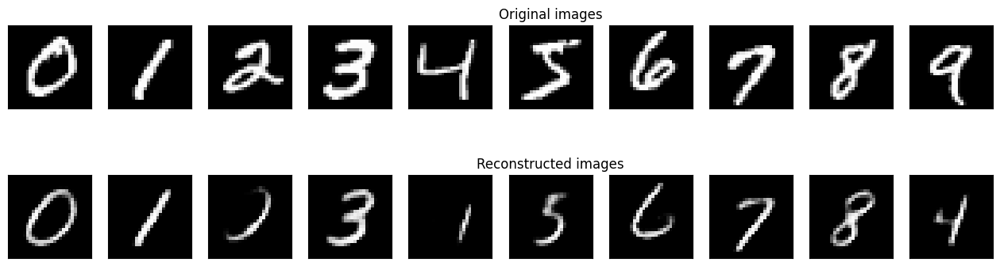

	 partial train loss (single batch): 22405.785156
	 partial train loss (single batch): 22623.019531
	 partial train loss (single batch): 22529.523438
	 partial train loss (single batch): 22403.263672
	 partial train loss (single batch): 22435.398438
	 partial train loss (single batch): 22547.046875
	 partial train loss (single batch): 22414.699219
	 partial train loss (single batch): 22412.718750
	 partial train loss (single batch): 22390.123047
	 partial train loss (single batch): 22286.044922
	 partial train loss (single batch): 22385.208984
	 partial train loss (single batch): 22491.908203
	 partial train loss (single batch): 22411.433594
	 partial train loss (single batch): 22424.412109
	 partial train loss (single batch): 22515.187500
	 partial train loss (single batch): 22158.847656
	 partial train loss (single batch): 22756.916016
	 partial train loss (single batch): 22349.263672
	 partial train loss (single batch): 22410.281250
	 partial train loss (single batch): 22150.306641


<Figure size 640x480 with 0 Axes>

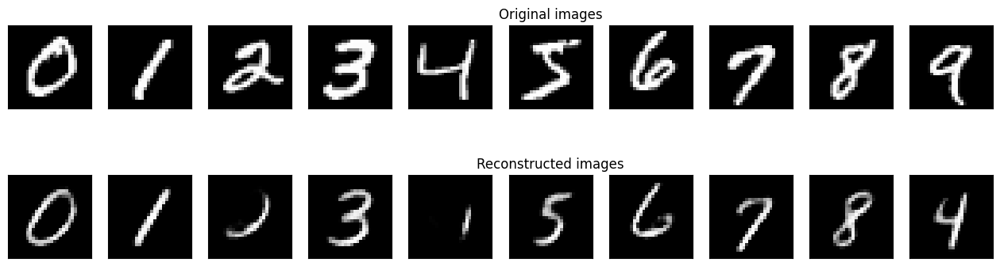

	 partial train loss (single batch): 22384.152344
	 partial train loss (single batch): 22592.646484
	 partial train loss (single batch): 22520.238281
	 partial train loss (single batch): 22384.683594
	 partial train loss (single batch): 22454.769531
	 partial train loss (single batch): 22514.707031
	 partial train loss (single batch): 22401.974609
	 partial train loss (single batch): 22437.884766
	 partial train loss (single batch): 22395.244141
	 partial train loss (single batch): 22307.019531
	 partial train loss (single batch): 22333.621094
	 partial train loss (single batch): 22475.031250
	 partial train loss (single batch): 22407.113281
	 partial train loss (single batch): 22416.816406
	 partial train loss (single batch): 22495.730469
	 partial train loss (single batch): 22172.958984
	 partial train loss (single batch): 22727.806641
	 partial train loss (single batch): 22328.939453
	 partial train loss (single batch): 22413.419922
	 partial train loss (single batch): 22115.558594


<Figure size 640x480 with 0 Axes>

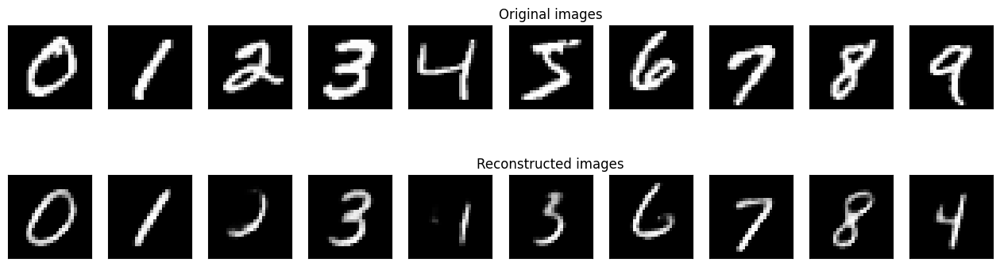

	 partial train loss (single batch): 22345.644531
	 partial train loss (single batch): 22598.033203
	 partial train loss (single batch): 22523.781250
	 partial train loss (single batch): 22386.796875
	 partial train loss (single batch): 22435.802734
	 partial train loss (single batch): 22591.894531
	 partial train loss (single batch): 22423.757812
	 partial train loss (single batch): 22403.554688
	 partial train loss (single batch): 22380.050781
	 partial train loss (single batch): 22298.099609
	 partial train loss (single batch): 22398.908203
	 partial train loss (single batch): 22498.376953
	 partial train loss (single batch): 22423.912109
	 partial train loss (single batch): 22406.136719
	 partial train loss (single batch): 22516.996094
	 partial train loss (single batch): 22155.689453
	 partial train loss (single batch): 22705.988281
	 partial train loss (single batch): 22339.148438
	 partial train loss (single batch): 22452.876953
	 partial train loss (single batch): 22158.591797


<Figure size 640x480 with 0 Axes>

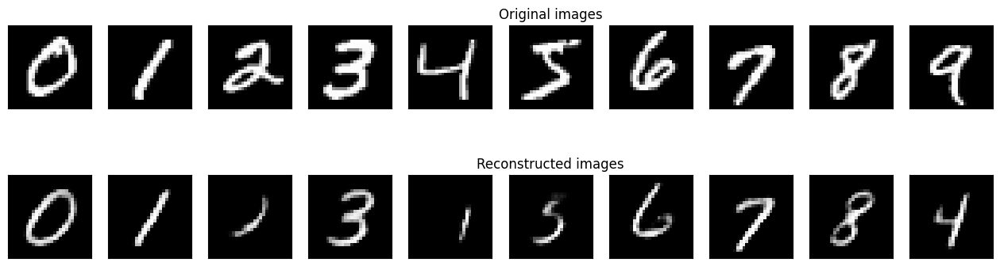

	 partial train loss (single batch): 22380.263672
	 partial train loss (single batch): 22596.164062
	 partial train loss (single batch): 22519.171875
	 partial train loss (single batch): 22393.933594
	 partial train loss (single batch): 22438.621094
	 partial train loss (single batch): 22559.699219
	 partial train loss (single batch): 22412.207031
	 partial train loss (single batch): 22390.386719
	 partial train loss (single batch): 22358.548828
	 partial train loss (single batch): 22297.675781
	 partial train loss (single batch): 22339.431641
	 partial train loss (single batch): 22488.271484
	 partial train loss (single batch): 22396.343750
	 partial train loss (single batch): 22379.394531
	 partial train loss (single batch): 22522.132812
	 partial train loss (single batch): 22179.746094
	 partial train loss (single batch): 22734.712891
	 partial train loss (single batch): 22314.738281
	 partial train loss (single batch): 22398.787109
	 partial train loss (single batch): 22129.324219


<Figure size 640x480 with 0 Axes>

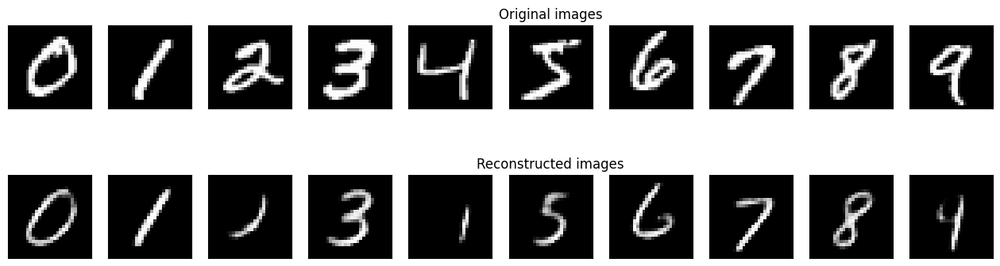

	 partial train loss (single batch): 22387.849609
	 partial train loss (single batch): 22605.113281
	 partial train loss (single batch): 22538.812500
	 partial train loss (single batch): 22405.835938
	 partial train loss (single batch): 22449.136719
	 partial train loss (single batch): 22519.314453
	 partial train loss (single batch): 22426.714844
	 partial train loss (single batch): 22400.230469
	 partial train loss (single batch): 22391.031250
	 partial train loss (single batch): 22317.373047
	 partial train loss (single batch): 22376.500000
	 partial train loss (single batch): 22503.591797
	 partial train loss (single batch): 22381.248047
	 partial train loss (single batch): 22427.796875
	 partial train loss (single batch): 22489.351562
	 partial train loss (single batch): 22167.296875
	 partial train loss (single batch): 22723.769531
	 partial train loss (single batch): 22341.173828
	 partial train loss (single batch): 22412.669922
	 partial train loss (single batch): 22111.767578


<Figure size 640x480 with 0 Axes>

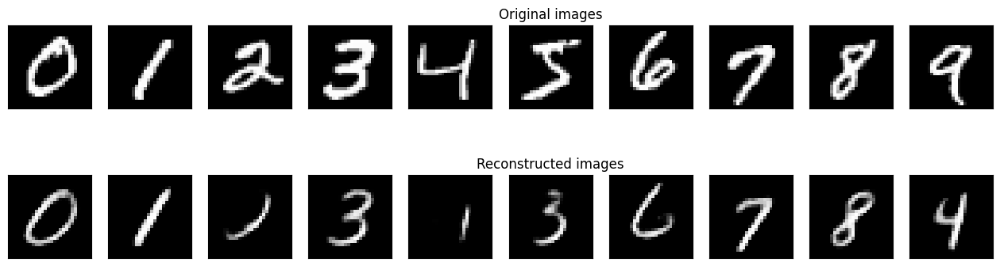

	 partial train loss (single batch): 22363.046875
	 partial train loss (single batch): 22611.972656
	 partial train loss (single batch): 22490.375000
	 partial train loss (single batch): 22389.972656
	 partial train loss (single batch): 22436.105469
	 partial train loss (single batch): 22537.525391
	 partial train loss (single batch): 22450.634766
	 partial train loss (single batch): 22384.615234
	 partial train loss (single batch): 22394.191406
	 partial train loss (single batch): 22290.687500
	 partial train loss (single batch): 22341.552734
	 partial train loss (single batch): 22511.947266
	 partial train loss (single batch): 22369.884766
	 partial train loss (single batch): 22387.652344
	 partial train loss (single batch): 22476.068359
	 partial train loss (single batch): 22145.607422
	 partial train loss (single batch): 22706.894531
	 partial train loss (single batch): 22263.884766
	 partial train loss (single batch): 22393.402344
	 partial train loss (single batch): 22132.890625


<Figure size 640x480 with 0 Axes>

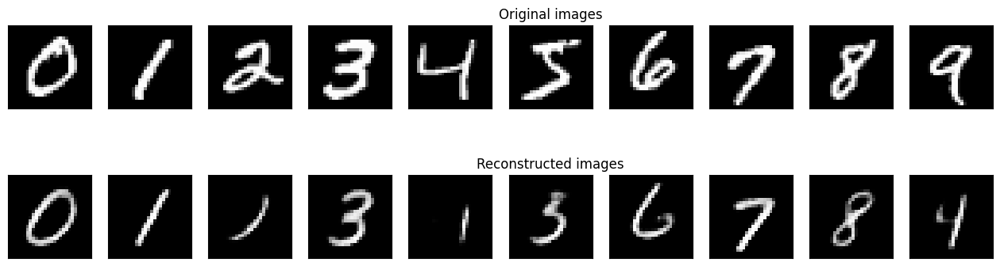

	 partial train loss (single batch): 22375.900391
	 partial train loss (single batch): 22606.099609
	 partial train loss (single batch): 22523.556641
	 partial train loss (single batch): 22380.548828
	 partial train loss (single batch): 22450.537109
	 partial train loss (single batch): 22555.902344
	 partial train loss (single batch): 22392.031250
	 partial train loss (single batch): 22404.621094
	 partial train loss (single batch): 22405.011719
	 partial train loss (single batch): 22309.837891
	 partial train loss (single batch): 22371.996094
	 partial train loss (single batch): 22477.433594
	 partial train loss (single batch): 22433.884766
	 partial train loss (single batch): 22391.697266
	 partial train loss (single batch): 22471.310547
	 partial train loss (single batch): 22171.298828
	 partial train loss (single batch): 22687.621094
	 partial train loss (single batch): 22333.701172
	 partial train loss (single batch): 22393.484375
	 partial train loss (single batch): 22096.613281


<Figure size 640x480 with 0 Axes>

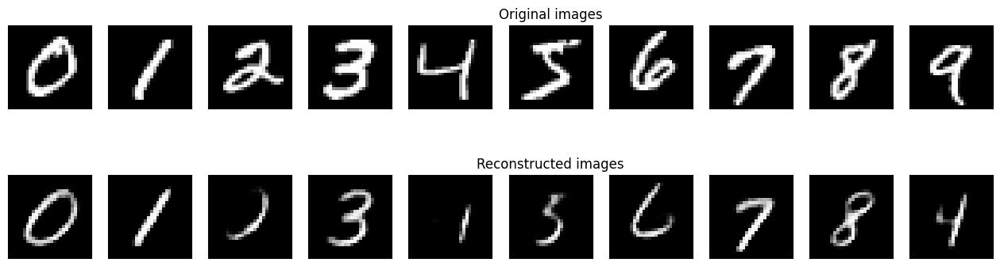

	 partial train loss (single batch): 22374.140625
	 partial train loss (single batch): 22603.052734
	 partial train loss (single batch): 22525.765625
	 partial train loss (single batch): 22371.333984
	 partial train loss (single batch): 22426.722656
	 partial train loss (single batch): 22529.712891
	 partial train loss (single batch): 22437.652344
	 partial train loss (single batch): 22400.125000
	 partial train loss (single batch): 22360.931641
	 partial train loss (single batch): 22291.652344
	 partial train loss (single batch): 22375.507812
	 partial train loss (single batch): 22495.382812
	 partial train loss (single batch): 22356.451172
	 partial train loss (single batch): 22387.062500
	 partial train loss (single batch): 22449.191406
	 partial train loss (single batch): 22165.576172
	 partial train loss (single batch): 22725.904297
	 partial train loss (single batch): 22304.376953
	 partial train loss (single batch): 22404.632812
	 partial train loss (single batch): 22072.324219


<Figure size 640x480 with 0 Axes>

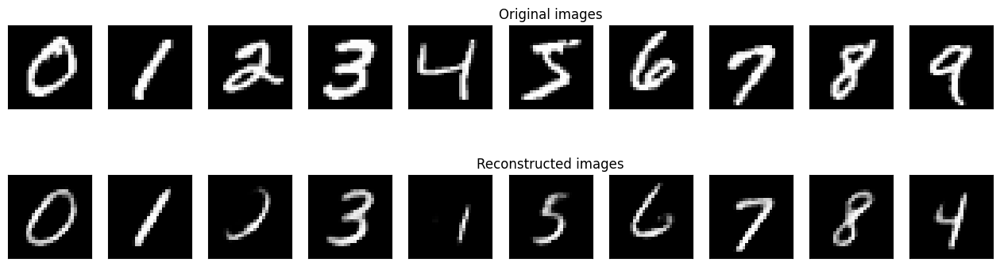

	 partial train loss (single batch): 22371.646484
	 partial train loss (single batch): 22607.111328
	 partial train loss (single batch): 22489.964844
	 partial train loss (single batch): 22406.138672
	 partial train loss (single batch): 22437.933594
	 partial train loss (single batch): 22512.869141
	 partial train loss (single batch): 22391.800781
	 partial train loss (single batch): 22410.246094
	 partial train loss (single batch): 22348.060547
	 partial train loss (single batch): 22316.082031
	 partial train loss (single batch): 22346.070312
	 partial train loss (single batch): 22478.718750
	 partial train loss (single batch): 22407.462891
	 partial train loss (single batch): 22403.171875
	 partial train loss (single batch): 22470.197266
	 partial train loss (single batch): 22153.322266
	 partial train loss (single batch): 22697.517578
	 partial train loss (single batch): 22323.357422
	 partial train loss (single batch): 22408.072266
	 partial train loss (single batch): 22127.613281


<Figure size 640x480 with 0 Axes>

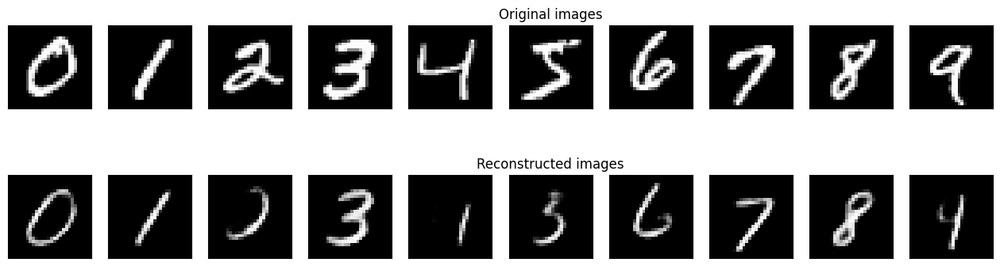

	 partial train loss (single batch): 22365.250000
	 partial train loss (single batch): 22599.207031
	 partial train loss (single batch): 22524.177734
	 partial train loss (single batch): 22378.708984
	 partial train loss (single batch): 22440.433594
	 partial train loss (single batch): 22525.148438
	 partial train loss (single batch): 22426.451172
	 partial train loss (single batch): 22416.490234
	 partial train loss (single batch): 22353.308594
	 partial train loss (single batch): 22298.775391
	 partial train loss (single batch): 22335.076172
	 partial train loss (single batch): 22469.107422
	 partial train loss (single batch): 22385.259766
	 partial train loss (single batch): 22385.123047
	 partial train loss (single batch): 22489.171875
	 partial train loss (single batch): 22146.173828
	 partial train loss (single batch): 22725.712891
	 partial train loss (single batch): 22313.310547
	 partial train loss (single batch): 22389.388672
	 partial train loss (single batch): 22091.656250


<Figure size 640x480 with 0 Axes>

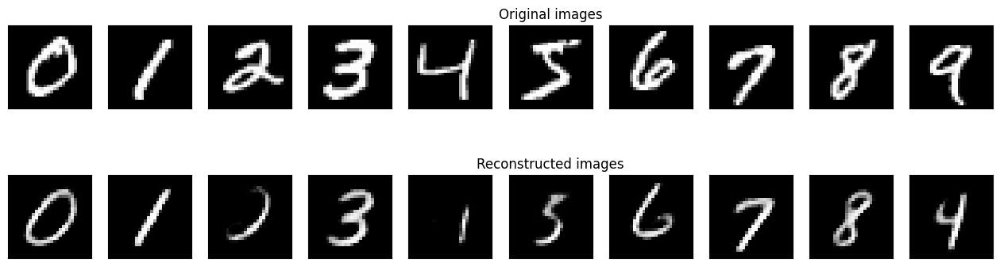

	 partial train loss (single batch): 22351.601562
	 partial train loss (single batch): 22605.835938
	 partial train loss (single batch): 22490.644531
	 partial train loss (single batch): 22391.519531
	 partial train loss (single batch): 22454.775391
	 partial train loss (single batch): 22543.140625
	 partial train loss (single batch): 22396.728516
	 partial train loss (single batch): 22405.656250
	 partial train loss (single batch): 22366.628906
	 partial train loss (single batch): 22287.824219
	 partial train loss (single batch): 22337.523438
	 partial train loss (single batch): 22534.621094
	 partial train loss (single batch): 22384.703125
	 partial train loss (single batch): 22382.126953
	 partial train loss (single batch): 22468.615234
	 partial train loss (single batch): 22164.363281
	 partial train loss (single batch): 22721.517578
	 partial train loss (single batch): 22290.548828
	 partial train loss (single batch): 22387.818359
	 partial train loss (single batch): 22102.546875


<Figure size 640x480 with 0 Axes>

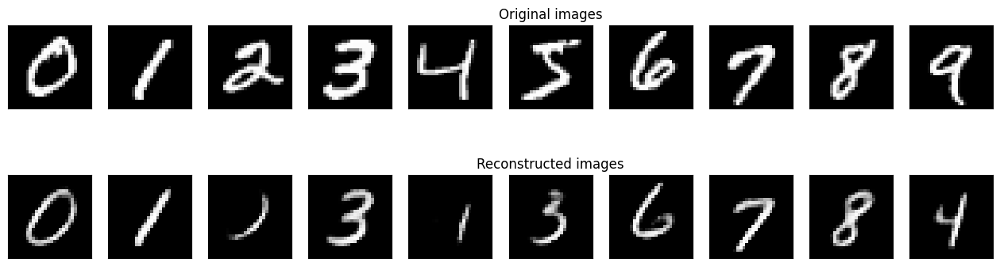

	 partial train loss (single batch): 22403.501953
	 partial train loss (single batch): 22597.478516
	 partial train loss (single batch): 22514.779297
	 partial train loss (single batch): 22420.818359
	 partial train loss (single batch): 22441.597656
	 partial train loss (single batch): 22512.546875
	 partial train loss (single batch): 22413.455078
	 partial train loss (single batch): 22380.724609
	 partial train loss (single batch): 22367.902344
	 partial train loss (single batch): 22278.128906
	 partial train loss (single batch): 22349.853516
	 partial train loss (single batch): 22470.580078
	 partial train loss (single batch): 22419.619141
	 partial train loss (single batch): 22391.656250
	 partial train loss (single batch): 22484.089844
	 partial train loss (single batch): 22166.593750
	 partial train loss (single batch): 22682.855469
	 partial train loss (single batch): 22342.123047
	 partial train loss (single batch): 22386.093750
	 partial train loss (single batch): 22108.488281


<Figure size 640x480 with 0 Axes>

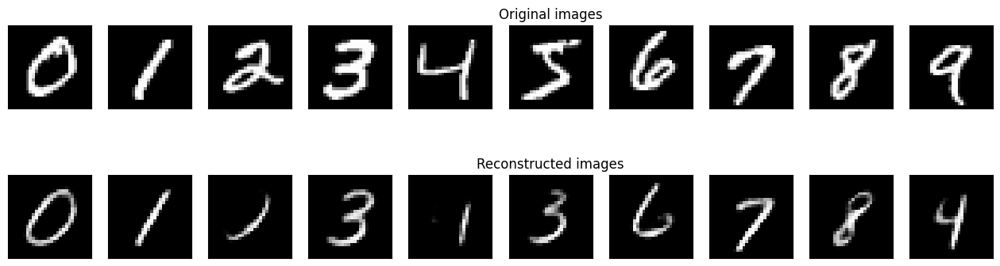

	 partial train loss (single batch): 22404.443359
	 partial train loss (single batch): 22591.083984
	 partial train loss (single batch): 22495.585938
	 partial train loss (single batch): 22392.617188
	 partial train loss (single batch): 22436.783203
	 partial train loss (single batch): 22502.435547
	 partial train loss (single batch): 22415.671875
	 partial train loss (single batch): 22394.548828
	 partial train loss (single batch): 22376.416016
	 partial train loss (single batch): 22291.023438
	 partial train loss (single batch): 22353.000000
	 partial train loss (single batch): 22448.046875
	 partial train loss (single batch): 22380.802734
	 partial train loss (single batch): 22404.220703
	 partial train loss (single batch): 22498.019531
	 partial train loss (single batch): 22138.367188
	 partial train loss (single batch): 22729.591797
	 partial train loss (single batch): 22284.316406
	 partial train loss (single batch): 22410.708984
	 partial train loss (single batch): 22082.386719


<Figure size 640x480 with 0 Axes>

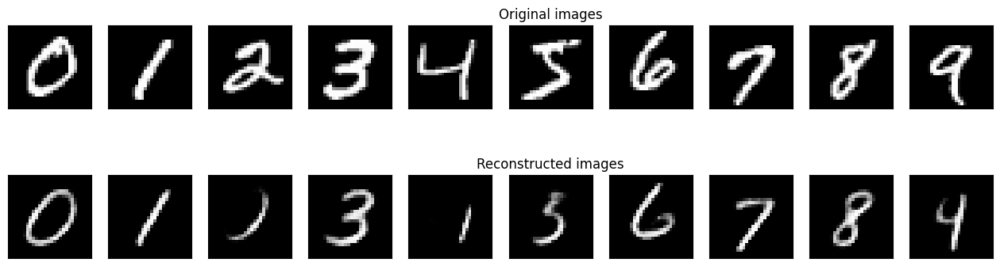

	 partial train loss (single batch): 22378.412109
	 partial train loss (single batch): 22594.585938
	 partial train loss (single batch): 22502.187500
	 partial train loss (single batch): 22373.595703
	 partial train loss (single batch): 22429.478516
	 partial train loss (single batch): 22504.152344
	 partial train loss (single batch): 22425.013672
	 partial train loss (single batch): 22394.349609
	 partial train loss (single batch): 22371.273438
	 partial train loss (single batch): 22265.300781
	 partial train loss (single batch): 22352.533203
	 partial train loss (single batch): 22454.214844
	 partial train loss (single batch): 22384.101562
	 partial train loss (single batch): 22384.851562
	 partial train loss (single batch): 22475.277344
	 partial train loss (single batch): 22146.357422
	 partial train loss (single batch): 22699.480469
	 partial train loss (single batch): 22288.007812
	 partial train loss (single batch): 22413.634766
	 partial train loss (single batch): 22077.900391


<Figure size 640x480 with 0 Axes>

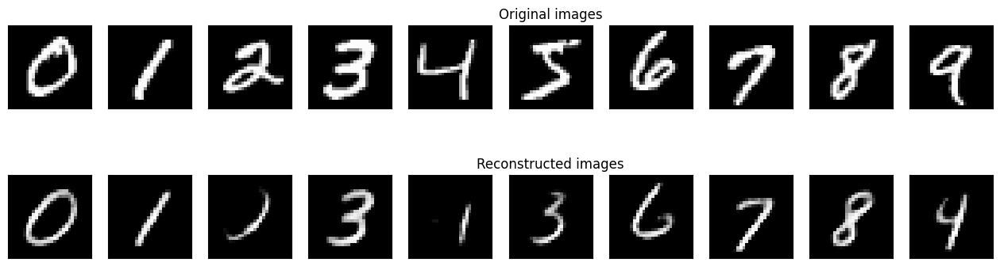

	 partial train loss (single batch): 22388.603516
	 partial train loss (single batch): 22618.453125
	 partial train loss (single batch): 22534.169922
	 partial train loss (single batch): 22387.074219
	 partial train loss (single batch): 22436.496094
	 partial train loss (single batch): 22537.962891
	 partial train loss (single batch): 22430.246094
	 partial train loss (single batch): 22356.746094
	 partial train loss (single batch): 22378.638672
	 partial train loss (single batch): 22298.035156
	 partial train loss (single batch): 22345.373047
	 partial train loss (single batch): 22485.134766
	 partial train loss (single batch): 22378.095703
	 partial train loss (single batch): 22350.302734
	 partial train loss (single batch): 22456.625000
	 partial train loss (single batch): 22160.009766
	 partial train loss (single batch): 22712.917969
	 partial train loss (single batch): 22306.935547
	 partial train loss (single batch): 22425.054688
	 partial train loss (single batch): 22065.791016


<Figure size 640x480 with 0 Axes>

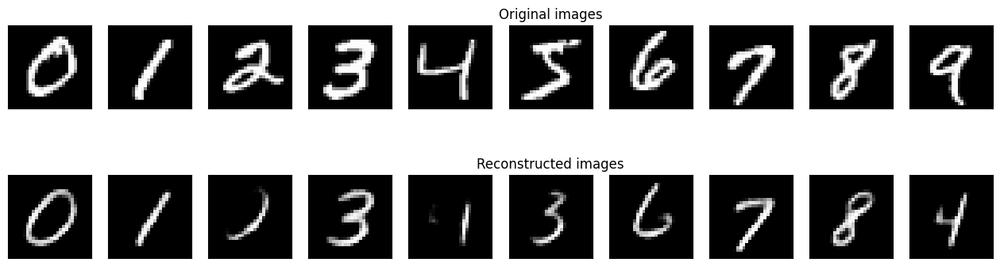

	 partial train loss (single batch): 22357.636719
	 partial train loss (single batch): 22658.125000
	 partial train loss (single batch): 22516.226562
	 partial train loss (single batch): 22382.375000
	 partial train loss (single batch): 22451.417969
	 partial train loss (single batch): 22493.130859
	 partial train loss (single batch): 22437.929688
	 partial train loss (single batch): 22372.943359
	 partial train loss (single batch): 22359.136719
	 partial train loss (single batch): 22297.859375
	 partial train loss (single batch): 22332.392578
	 partial train loss (single batch): 22479.214844
	 partial train loss (single batch): 22405.791016
	 partial train loss (single batch): 22411.091797
	 partial train loss (single batch): 22460.027344
	 partial train loss (single batch): 22131.255859
	 partial train loss (single batch): 22758.857422
	 partial train loss (single batch): 22285.244141
	 partial train loss (single batch): 22401.695312
	 partial train loss (single batch): 22090.896484


<Figure size 640x480 with 0 Axes>

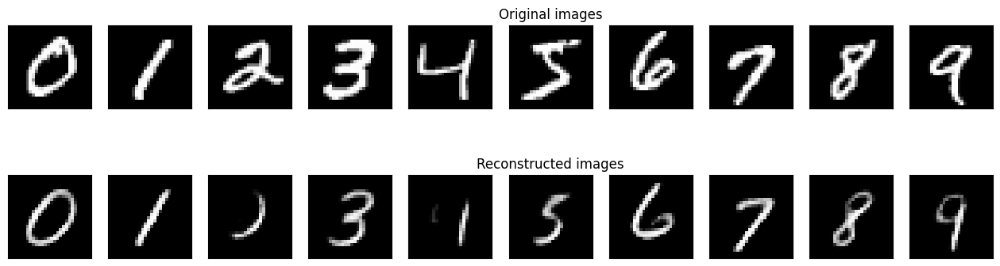

	 partial train loss (single batch): 22382.373047
	 partial train loss (single batch): 22583.265625
	 partial train loss (single batch): 22471.070312
	 partial train loss (single batch): 22382.058594
	 partial train loss (single batch): 22435.101562
	 partial train loss (single batch): 22495.162109
	 partial train loss (single batch): 22434.681641
	 partial train loss (single batch): 22373.841797
	 partial train loss (single batch): 22390.845703
	 partial train loss (single batch): 22291.912109
	 partial train loss (single batch): 22387.890625
	 partial train loss (single batch): 22464.216797
	 partial train loss (single batch): 22385.507812
	 partial train loss (single batch): 22389.455078
	 partial train loss (single batch): 22468.259766
	 partial train loss (single batch): 22152.878906
	 partial train loss (single batch): 22663.996094
	 partial train loss (single batch): 22309.263672
	 partial train loss (single batch): 22419.152344
	 partial train loss (single batch): 22103.687500


<Figure size 640x480 with 0 Axes>

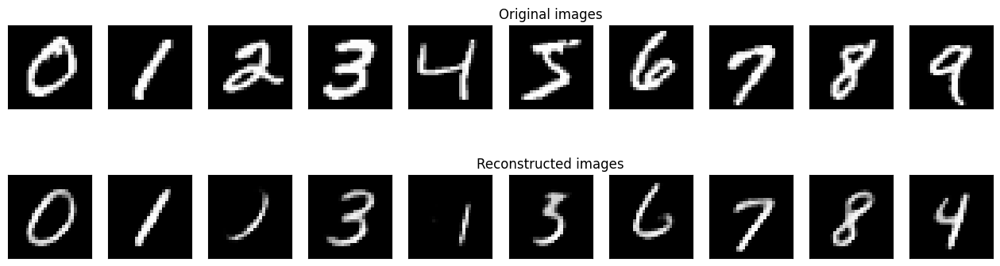

	 partial train loss (single batch): 22380.980469
	 partial train loss (single batch): 22578.281250
	 partial train loss (single batch): 22489.978516
	 partial train loss (single batch): 22377.513672
	 partial train loss (single batch): 22446.886719
	 partial train loss (single batch): 22490.392578
	 partial train loss (single batch): 22406.521484
	 partial train loss (single batch): 22400.539062
	 partial train loss (single batch): 22358.335938
	 partial train loss (single batch): 22261.189453
	 partial train loss (single batch): 22338.089844
	 partial train loss (single batch): 22470.158203
	 partial train loss (single batch): 22390.017578
	 partial train loss (single batch): 22388.693359
	 partial train loss (single batch): 22435.255859
	 partial train loss (single batch): 22115.632812
	 partial train loss (single batch): 22695.441406
	 partial train loss (single batch): 22289.142578
	 partial train loss (single batch): 22404.861328
	 partial train loss (single batch): 22099.207031


<Figure size 640x480 with 0 Axes>

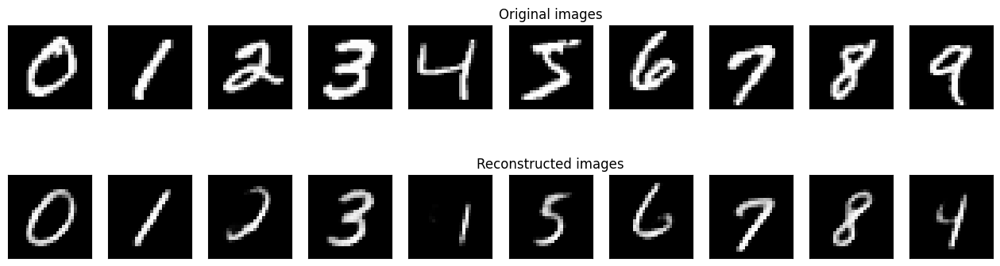

	 partial train loss (single batch): 22362.421875
	 partial train loss (single batch): 22603.742188
	 partial train loss (single batch): 22480.679688
	 partial train loss (single batch): 22364.345703
	 partial train loss (single batch): 22440.039062
	 partial train loss (single batch): 22490.810547
	 partial train loss (single batch): 22389.968750
	 partial train loss (single batch): 22377.677734
	 partial train loss (single batch): 22398.146484
	 partial train loss (single batch): 22277.732422
	 partial train loss (single batch): 22358.765625
	 partial train loss (single batch): 22463.509766
	 partial train loss (single batch): 22372.498047
	 partial train loss (single batch): 22423.328125
	 partial train loss (single batch): 22439.320312
	 partial train loss (single batch): 22103.837891
	 partial train loss (single batch): 22720.568359
	 partial train loss (single batch): 22293.943359
	 partial train loss (single batch): 22388.017578
	 partial train loss (single batch): 22076.253906


<Figure size 640x480 with 0 Axes>

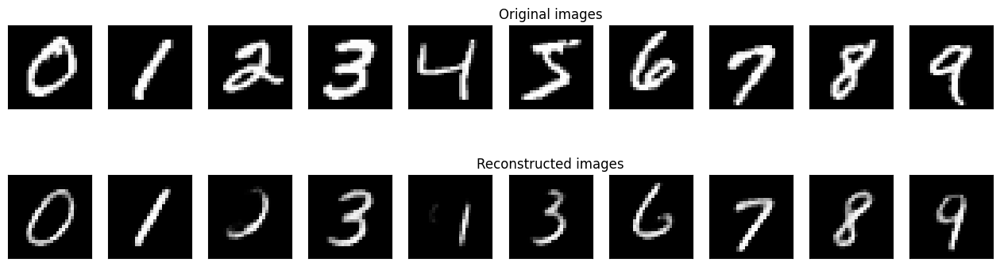

	 partial train loss (single batch): 22354.421875
	 partial train loss (single batch): 22605.587891
	 partial train loss (single batch): 22531.339844
	 partial train loss (single batch): 22373.203125
	 partial train loss (single batch): 22431.238281
	 partial train loss (single batch): 22549.724609
	 partial train loss (single batch): 22413.130859
	 partial train loss (single batch): 22367.775391
	 partial train loss (single batch): 22379.230469
	 partial train loss (single batch): 22298.906250
	 partial train loss (single batch): 22389.509766
	 partial train loss (single batch): 22474.337891
	 partial train loss (single batch): 22385.267578
	 partial train loss (single batch): 22402.218750
	 partial train loss (single batch): 22452.298828
	 partial train loss (single batch): 22144.292969
	 partial train loss (single batch): 22707.750000
	 partial train loss (single batch): 22295.503906
	 partial train loss (single batch): 22395.919922
	 partial train loss (single batch): 22069.767578


<Figure size 640x480 with 0 Axes>

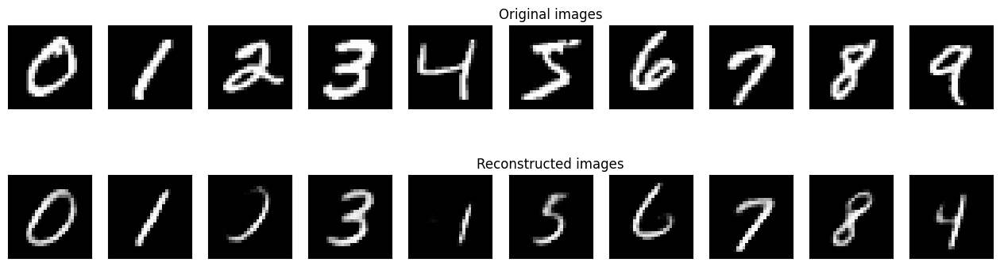

	 partial train loss (single batch): 22366.468750
	 partial train loss (single batch): 22579.576172
	 partial train loss (single batch): 22492.677734
	 partial train loss (single batch): 22364.535156
	 partial train loss (single batch): 22417.091797
	 partial train loss (single batch): 22535.306641
	 partial train loss (single batch): 22396.033203
	 partial train loss (single batch): 22398.734375
	 partial train loss (single batch): 22356.910156
	 partial train loss (single batch): 22255.794922
	 partial train loss (single batch): 22358.105469
	 partial train loss (single batch): 22488.589844
	 partial train loss (single batch): 22358.576172
	 partial train loss (single batch): 22375.974609
	 partial train loss (single batch): 22451.990234
	 partial train loss (single batch): 22113.498047
	 partial train loss (single batch): 22713.800781
	 partial train loss (single batch): 22261.593750
	 partial train loss (single batch): 22414.404297
	 partial train loss (single batch): 22087.386719


<Figure size 640x480 with 0 Axes>

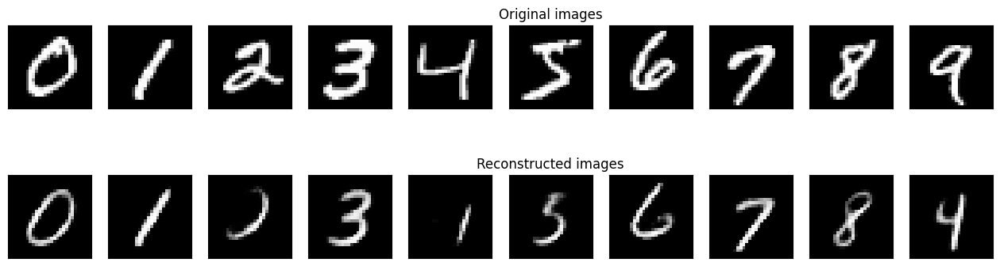

	 partial train loss (single batch): 22348.318359
	 partial train loss (single batch): 22585.359375
	 partial train loss (single batch): 22470.292969
	 partial train loss (single batch): 22387.250000
	 partial train loss (single batch): 22387.494141
	 partial train loss (single batch): 22487.925781
	 partial train loss (single batch): 22386.546875
	 partial train loss (single batch): 22370.710938
	 partial train loss (single batch): 22350.619141
	 partial train loss (single batch): 22263.281250
	 partial train loss (single batch): 22351.703125
	 partial train loss (single batch): 22480.261719
	 partial train loss (single batch): 22403.369141
	 partial train loss (single batch): 22398.179688
	 partial train loss (single batch): 22448.222656
	 partial train loss (single batch): 22118.044922
	 partial train loss (single batch): 22681.974609
	 partial train loss (single batch): 22326.353516
	 partial train loss (single batch): 22383.193359
	 partial train loss (single batch): 22055.468750


<Figure size 640x480 with 0 Axes>

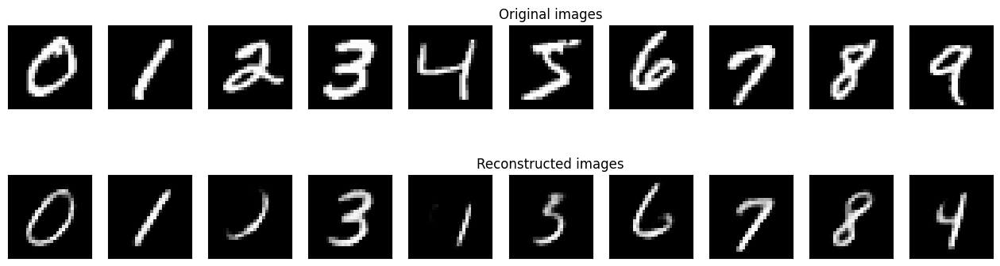

	 partial train loss (single batch): 22380.037109
	 partial train loss (single batch): 22591.863281
	 partial train loss (single batch): 22486.884766
	 partial train loss (single batch): 22364.822266
	 partial train loss (single batch): 22418.951172
	 partial train loss (single batch): 22476.021484
	 partial train loss (single batch): 22394.041016
	 partial train loss (single batch): 22389.134766
	 partial train loss (single batch): 22340.876953
	 partial train loss (single batch): 22246.835938
	 partial train loss (single batch): 22354.330078
	 partial train loss (single batch): 22441.996094
	 partial train loss (single batch): 22361.744141
	 partial train loss (single batch): 22352.062500
	 partial train loss (single batch): 22434.505859
	 partial train loss (single batch): 22127.414062
	 partial train loss (single batch): 22702.888672
	 partial train loss (single batch): 22269.798828
	 partial train loss (single batch): 22422.468750
	 partial train loss (single batch): 22090.353516


<Figure size 640x480 with 0 Axes>

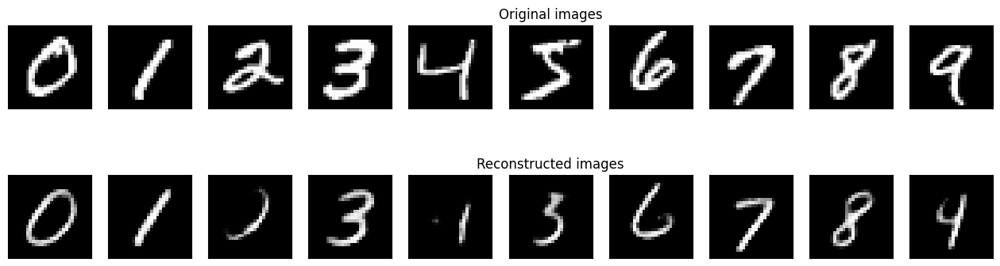

	 partial train loss (single batch): 22366.496094
	 partial train loss (single batch): 22597.876953
	 partial train loss (single batch): 22494.339844
	 partial train loss (single batch): 22350.287109
	 partial train loss (single batch): 22434.097656
	 partial train loss (single batch): 22512.498047
	 partial train loss (single batch): 22416.455078
	 partial train loss (single batch): 22361.199219
	 partial train loss (single batch): 22345.964844
	 partial train loss (single batch): 22251.318359
	 partial train loss (single batch): 22365.273438
	 partial train loss (single batch): 22448.003906
	 partial train loss (single batch): 22375.275391
	 partial train loss (single batch): 22394.412109
	 partial train loss (single batch): 22441.173828
	 partial train loss (single batch): 22109.279297
	 partial train loss (single batch): 22714.568359
	 partial train loss (single batch): 22283.960938
	 partial train loss (single batch): 22399.091797
	 partial train loss (single batch): 22081.996094


<Figure size 640x480 with 0 Axes>

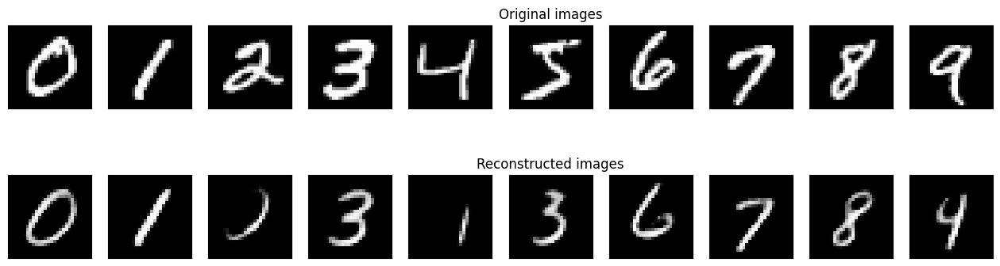

	 partial train loss (single batch): 22372.328125
	 partial train loss (single batch): 22577.582031
	 partial train loss (single batch): 22491.843750
	 partial train loss (single batch): 22375.060547
	 partial train loss (single batch): 22437.634766
	 partial train loss (single batch): 22513.398438
	 partial train loss (single batch): 22436.007812
	 partial train loss (single batch): 22382.707031
	 partial train loss (single batch): 22365.605469
	 partial train loss (single batch): 22315.402344
	 partial train loss (single batch): 22366.144531
	 partial train loss (single batch): 22486.878906
	 partial train loss (single batch): 22423.726562
	 partial train loss (single batch): 22390.636719
	 partial train loss (single batch): 22471.554688
	 partial train loss (single batch): 22137.431641
	 partial train loss (single batch): 22665.210938
	 partial train loss (single batch): 22261.523438
	 partial train loss (single batch): 22423.222656
	 partial train loss (single batch): 22099.164062


<Figure size 640x480 with 0 Axes>

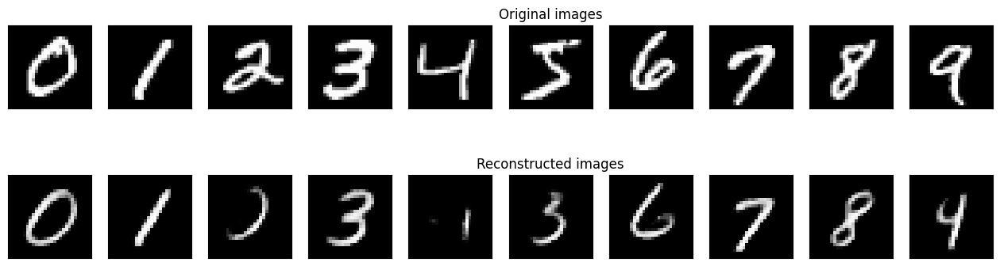

	 partial train loss (single batch): 22365.416016
	 partial train loss (single batch): 22590.003906
	 partial train loss (single batch): 22468.615234
	 partial train loss (single batch): 22367.990234
	 partial train loss (single batch): 22446.673828
	 partial train loss (single batch): 22507.507812
	 partial train loss (single batch): 22408.218750
	 partial train loss (single batch): 22413.871094
	 partial train loss (single batch): 22320.265625
	 partial train loss (single batch): 22265.625000
	 partial train loss (single batch): 22346.076172
	 partial train loss (single batch): 22491.068359
	 partial train loss (single batch): 22394.814453
	 partial train loss (single batch): 22383.796875
	 partial train loss (single batch): 22465.322266
	 partial train loss (single batch): 22124.542969
	 partial train loss (single batch): 22690.662109
	 partial train loss (single batch): 22320.652344
	 partial train loss (single batch): 22424.572266
	 partial train loss (single batch): 22045.410156


<Figure size 640x480 with 0 Axes>

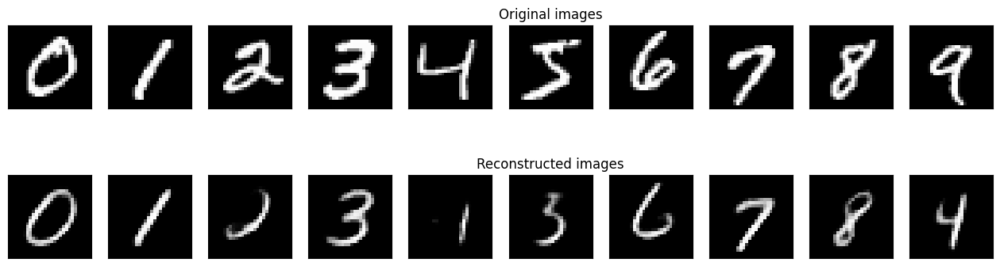

	 partial train loss (single batch): 22384.269531
	 partial train loss (single batch): 22612.333984
	 partial train loss (single batch): 22485.023438
	 partial train loss (single batch): 22366.361328
	 partial train loss (single batch): 22485.279297
	 partial train loss (single batch): 22534.251953
	 partial train loss (single batch): 22409.070312
	 partial train loss (single batch): 22350.365234
	 partial train loss (single batch): 22335.675781
	 partial train loss (single batch): 22262.486328
	 partial train loss (single batch): 22354.925781
	 partial train loss (single batch): 22466.634766
	 partial train loss (single batch): 22377.421875
	 partial train loss (single batch): 22391.742188
	 partial train loss (single batch): 22458.181641
	 partial train loss (single batch): 22121.687500
	 partial train loss (single batch): 22697.605469
	 partial train loss (single batch): 22309.492188
	 partial train loss (single batch): 22394.986328
	 partial train loss (single batch): 22085.412109


<Figure size 640x480 with 0 Axes>

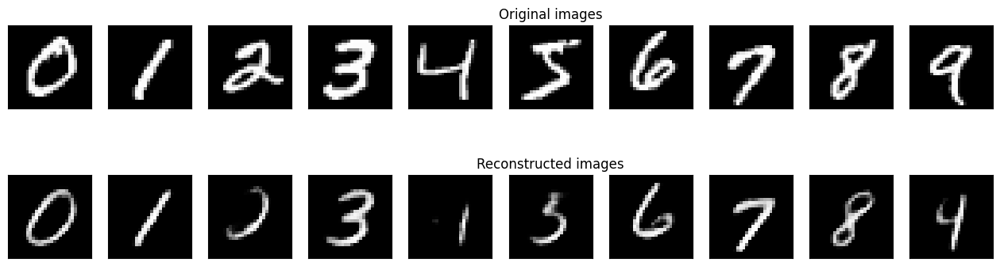

	 partial train loss (single batch): 22368.125000
	 partial train loss (single batch): 22597.328125
	 partial train loss (single batch): 22483.347656
	 partial train loss (single batch): 22379.720703
	 partial train loss (single batch): 22413.669922
	 partial train loss (single batch): 22511.294922
	 partial train loss (single batch): 22430.398438
	 partial train loss (single batch): 22357.841797
	 partial train loss (single batch): 22341.720703
	 partial train loss (single batch): 22250.164062
	 partial train loss (single batch): 22321.970703
	 partial train loss (single batch): 22474.656250
	 partial train loss (single batch): 22369.337891
	 partial train loss (single batch): 22372.052734
	 partial train loss (single batch): 22438.576172
	 partial train loss (single batch): 22137.144531
	 partial train loss (single batch): 22714.453125
	 partial train loss (single batch): 22291.001953
	 partial train loss (single batch): 22428.945312
	 partial train loss (single batch): 22110.701172


<Figure size 640x480 with 0 Axes>

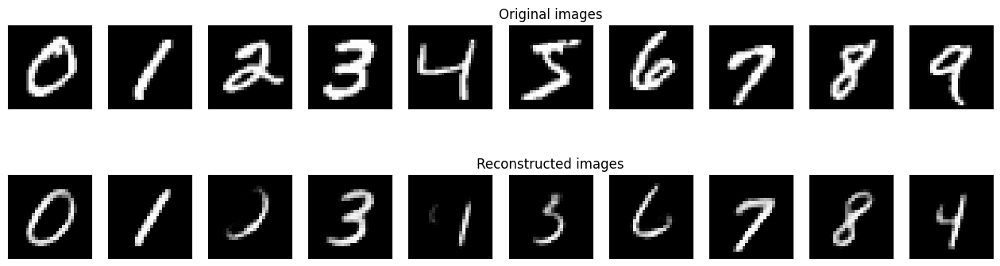

	 partial train loss (single batch): 22346.962891
	 partial train loss (single batch): 22580.734375
	 partial train loss (single batch): 22468.906250
	 partial train loss (single batch): 22365.005859
	 partial train loss (single batch): 22439.169922
	 partial train loss (single batch): 22522.710938
	 partial train loss (single batch): 22417.394531
	 partial train loss (single batch): 22343.435547
	 partial train loss (single batch): 22348.210938
	 partial train loss (single batch): 22298.273438
	 partial train loss (single batch): 22339.324219
	 partial train loss (single batch): 22491.050781
	 partial train loss (single batch): 22403.351562
	 partial train loss (single batch): 22376.763672
	 partial train loss (single batch): 22437.947266
	 partial train loss (single batch): 22117.861328
	 partial train loss (single batch): 22671.281250
	 partial train loss (single batch): 22240.271484
	 partial train loss (single batch): 22426.003906
	 partial train loss (single batch): 22131.513672


<Figure size 640x480 with 0 Axes>

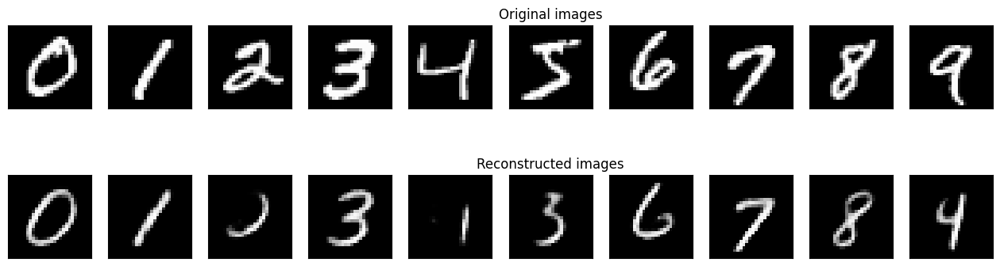

	 partial train loss (single batch): 22363.085938
	 partial train loss (single batch): 22583.687500
	 partial train loss (single batch): 22495.101562
	 partial train loss (single batch): 22403.048828
	 partial train loss (single batch): 22464.041016
	 partial train loss (single batch): 22486.117188
	 partial train loss (single batch): 22404.117188
	 partial train loss (single batch): 22362.302734
	 partial train loss (single batch): 22352.222656
	 partial train loss (single batch): 22278.617188
	 partial train loss (single batch): 22342.804688
	 partial train loss (single batch): 22416.439453
	 partial train loss (single batch): 22372.039062
	 partial train loss (single batch): 22403.865234
	 partial train loss (single batch): 22458.203125
	 partial train loss (single batch): 22127.240234
	 partial train loss (single batch): 22669.568359
	 partial train loss (single batch): 22282.029297
	 partial train loss (single batch): 22402.005859
	 partial train loss (single batch): 22096.333984


<Figure size 640x480 with 0 Axes>

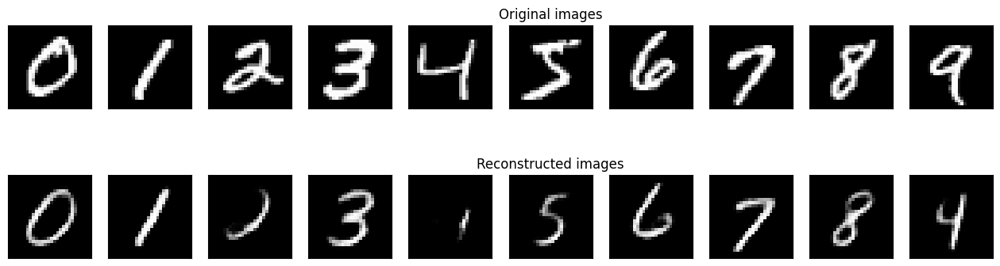

	 partial train loss (single batch): 22386.603516
	 partial train loss (single batch): 22572.248047
	 partial train loss (single batch): 22495.945312
	 partial train loss (single batch): 22359.914062
	 partial train loss (single batch): 22440.304688
	 partial train loss (single batch): 22491.914062
	 partial train loss (single batch): 22401.595703
	 partial train loss (single batch): 22383.267578
	 partial train loss (single batch): 22343.894531
	 partial train loss (single batch): 22276.187500
	 partial train loss (single batch): 22368.535156
	 partial train loss (single batch): 22455.429688
	 partial train loss (single batch): 22384.767578
	 partial train loss (single batch): 22381.062500
	 partial train loss (single batch): 22479.328125
	 partial train loss (single batch): 22126.460938
	 partial train loss (single batch): 22656.099609
	 partial train loss (single batch): 22279.427734
	 partial train loss (single batch): 22419.957031
	 partial train loss (single batch): 22065.789062


<Figure size 640x480 with 0 Axes>

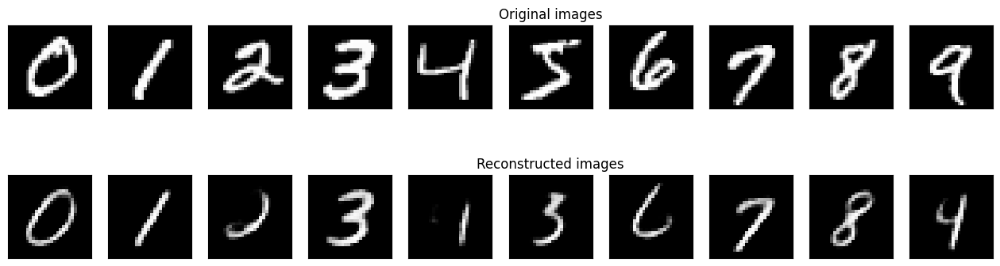

	 partial train loss (single batch): 22370.957031
	 partial train loss (single batch): 22601.009766
	 partial train loss (single batch): 22496.066406
	 partial train loss (single batch): 22347.888672
	 partial train loss (single batch): 22428.457031
	 partial train loss (single batch): 22464.996094
	 partial train loss (single batch): 22371.107422
	 partial train loss (single batch): 22386.335938
	 partial train loss (single batch): 22323.765625
	 partial train loss (single batch): 22255.337891
	 partial train loss (single batch): 22352.892578
	 partial train loss (single batch): 22441.826172
	 partial train loss (single batch): 22382.921875
	 partial train loss (single batch): 22342.744141
	 partial train loss (single batch): 22413.193359
	 partial train loss (single batch): 22140.113281
	 partial train loss (single batch): 22687.478516
	 partial train loss (single batch): 22250.117188
	 partial train loss (single batch): 22390.578125
	 partial train loss (single batch): 22062.136719


<Figure size 640x480 with 0 Axes>

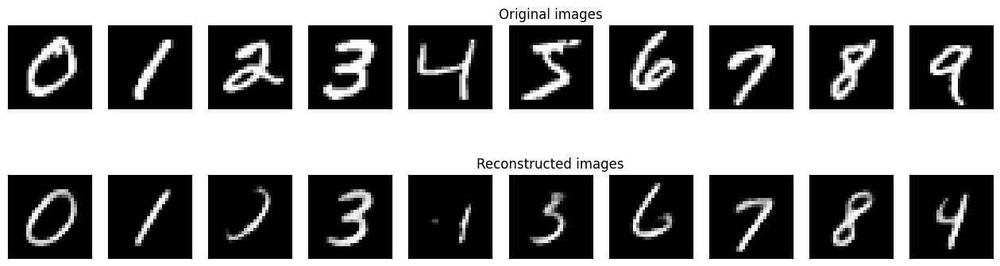

	 partial train loss (single batch): 22361.375000
	 partial train loss (single batch): 22593.966797
	 partial train loss (single batch): 22485.814453
	 partial train loss (single batch): 22346.000000
	 partial train loss (single batch): 22414.490234
	 partial train loss (single batch): 22490.453125
	 partial train loss (single batch): 22411.634766
	 partial train loss (single batch): 22342.222656
	 partial train loss (single batch): 22328.435547
	 partial train loss (single batch): 22260.443359
	 partial train loss (single batch): 22348.607422
	 partial train loss (single batch): 22489.785156
	 partial train loss (single batch): 22385.244141
	 partial train loss (single batch): 22383.396484
	 partial train loss (single batch): 22440.097656
	 partial train loss (single batch): 22088.275391
	 partial train loss (single batch): 22699.947266
	 partial train loss (single batch): 22284.468750
	 partial train loss (single batch): 22380.601562
	 partial train loss (single batch): 22067.498047


<Figure size 640x480 with 0 Axes>

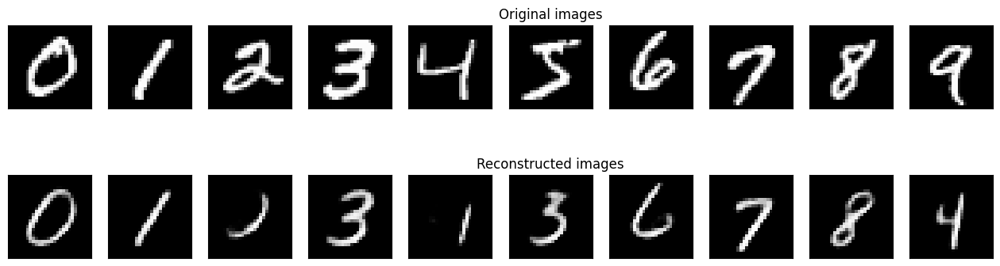

	 partial train loss (single batch): 22356.648438
	 partial train loss (single batch): 22593.142578
	 partial train loss (single batch): 22462.583984
	 partial train loss (single batch): 22337.298828
	 partial train loss (single batch): 22463.119141
	 partial train loss (single batch): 22540.041016
	 partial train loss (single batch): 22395.773438
	 partial train loss (single batch): 22364.980469
	 partial train loss (single batch): 22352.490234
	 partial train loss (single batch): 22278.738281
	 partial train loss (single batch): 22352.035156
	 partial train loss (single batch): 22455.470703
	 partial train loss (single batch): 22388.410156
	 partial train loss (single batch): 22384.107422
	 partial train loss (single batch): 22394.583984
	 partial train loss (single batch): 22137.582031
	 partial train loss (single batch): 22692.089844
	 partial train loss (single batch): 22278.966797
	 partial train loss (single batch): 22387.005859
	 partial train loss (single batch): 22048.542969


<Figure size 640x480 with 0 Axes>

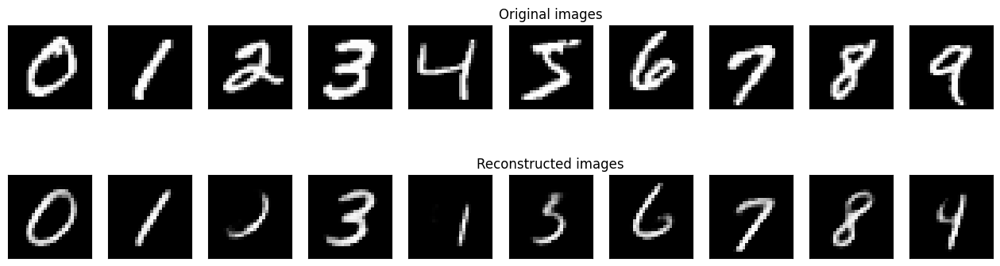

	 partial train loss (single batch): 22350.361328
	 partial train loss (single batch): 22597.341797
	 partial train loss (single batch): 22488.591797
	 partial train loss (single batch): 22343.396484
	 partial train loss (single batch): 22427.804688
	 partial train loss (single batch): 22501.718750
	 partial train loss (single batch): 22396.261719
	 partial train loss (single batch): 22341.910156
	 partial train loss (single batch): 22332.291016
	 partial train loss (single batch): 22246.912109
	 partial train loss (single batch): 22326.542969
	 partial train loss (single batch): 22439.216797
	 partial train loss (single batch): 22385.691406
	 partial train loss (single batch): 22386.187500
	 partial train loss (single batch): 22421.785156
	 partial train loss (single batch): 22136.523438
	 partial train loss (single batch): 22654.400391
	 partial train loss (single batch): 22277.521484
	 partial train loss (single batch): 22406.195312
	 partial train loss (single batch): 22085.070312


<Figure size 640x480 with 0 Axes>

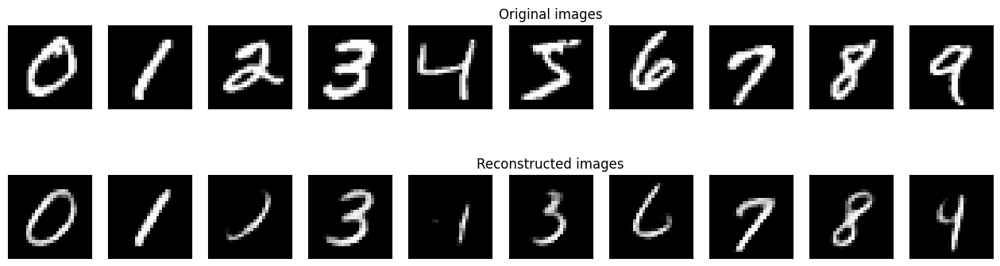

	 partial train loss (single batch): 22375.544922
	 partial train loss (single batch): 22569.490234
	 partial train loss (single batch): 22520.478516
	 partial train loss (single batch): 22379.031250
	 partial train loss (single batch): 22443.998047
	 partial train loss (single batch): 22483.884766
	 partial train loss (single batch): 22378.007812
	 partial train loss (single batch): 22335.164062
	 partial train loss (single batch): 22326.011719
	 partial train loss (single batch): 22269.615234
	 partial train loss (single batch): 22318.281250
	 partial train loss (single batch): 22462.015625
	 partial train loss (single batch): 22378.410156
	 partial train loss (single batch): 22365.199219
	 partial train loss (single batch): 22442.376953
	 partial train loss (single batch): 22136.908203
	 partial train loss (single batch): 22678.064453
	 partial train loss (single batch): 22253.193359
	 partial train loss (single batch): 22409.443359
	 partial train loss (single batch): 22053.052734


<Figure size 640x480 with 0 Axes>

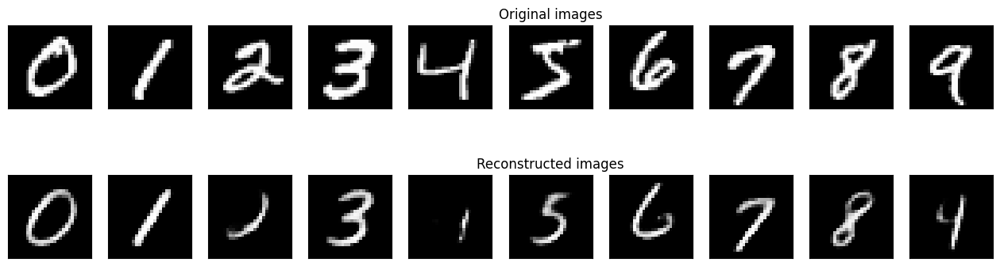

	 partial train loss (single batch): 22371.960938
	 partial train loss (single batch): 22584.050781
	 partial train loss (single batch): 22464.214844
	 partial train loss (single batch): 22367.417969
	 partial train loss (single batch): 22458.210938
	 partial train loss (single batch): 22519.001953
	 partial train loss (single batch): 22418.248047
	 partial train loss (single batch): 22397.744141
	 partial train loss (single batch): 22328.246094
	 partial train loss (single batch): 22273.974609
	 partial train loss (single batch): 22325.755859
	 partial train loss (single batch): 22476.519531
	 partial train loss (single batch): 22353.449219
	 partial train loss (single batch): 22411.572266
	 partial train loss (single batch): 22400.109375
	 partial train loss (single batch): 22130.853516
	 partial train loss (single batch): 22686.080078
	 partial train loss (single batch): 22277.419922
	 partial train loss (single batch): 22380.755859
	 partial train loss (single batch): 22040.830078


<Figure size 640x480 with 0 Axes>

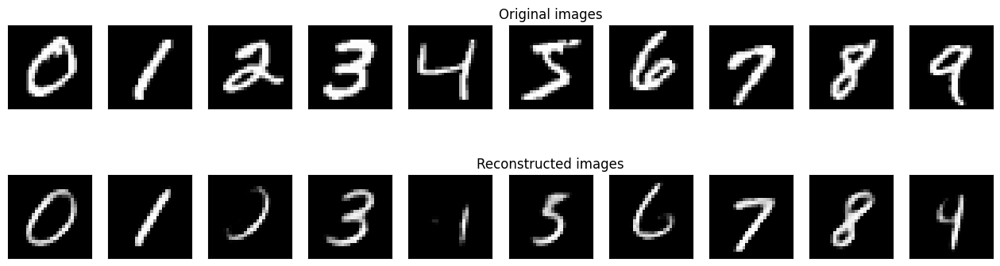

	 partial train loss (single batch): 22363.794922
	 partial train loss (single batch): 22582.949219
	 partial train loss (single batch): 22483.587891
	 partial train loss (single batch): 22344.830078
	 partial train loss (single batch): 22435.916016
	 partial train loss (single batch): 22542.201172
	 partial train loss (single batch): 22388.521484
	 partial train loss (single batch): 22386.548828
	 partial train loss (single batch): 22338.882812
	 partial train loss (single batch): 22271.578125
	 partial train loss (single batch): 22309.814453
	 partial train loss (single batch): 22465.121094
	 partial train loss (single batch): 22363.761719
	 partial train loss (single batch): 22375.533203
	 partial train loss (single batch): 22428.699219
	 partial train loss (single batch): 22101.101562
	 partial train loss (single batch): 22696.546875
	 partial train loss (single batch): 22273.285156
	 partial train loss (single batch): 22413.505859
	 partial train loss (single batch): 22093.671875


<Figure size 640x480 with 0 Axes>

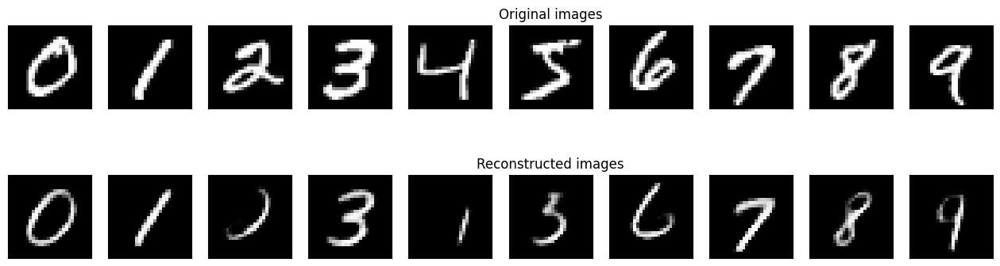

	 partial train loss (single batch): 22381.419922
	 partial train loss (single batch): 22548.431641
	 partial train loss (single batch): 22476.410156
	 partial train loss (single batch): 22387.171875
	 partial train loss (single batch): 22450.753906
	 partial train loss (single batch): 22486.886719
	 partial train loss (single batch): 22410.365234
	 partial train loss (single batch): 22343.566406
	 partial train loss (single batch): 22332.808594
	 partial train loss (single batch): 22307.078125
	 partial train loss (single batch): 22308.304688
	 partial train loss (single batch): 22444.935547
	 partial train loss (single batch): 22407.230469
	 partial train loss (single batch): 22379.099609
	 partial train loss (single batch): 22414.738281
	 partial train loss (single batch): 22148.181641
	 partial train loss (single batch): 22687.464844
	 partial train loss (single batch): 22259.257812
	 partial train loss (single batch): 22395.554688
	 partial train loss (single batch): 22036.023438


<Figure size 640x480 with 0 Axes>

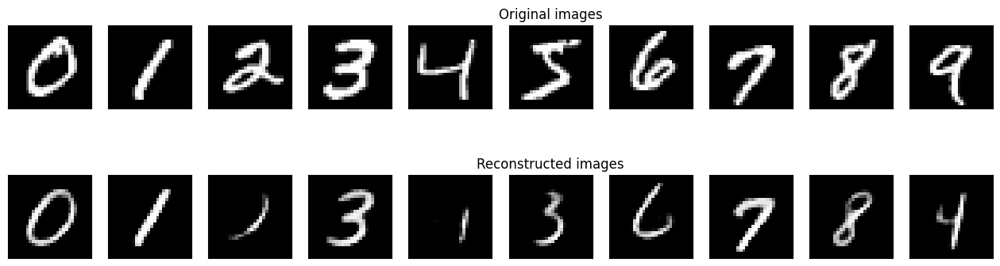

	 partial train loss (single batch): 22364.142578
	 partial train loss (single batch): 22609.130859
	 partial train loss (single batch): 22496.742188
	 partial train loss (single batch): 22370.947266
	 partial train loss (single batch): 22449.789062
	 partial train loss (single batch): 22519.884766
	 partial train loss (single batch): 22403.441406
	 partial train loss (single batch): 22324.244141
	 partial train loss (single batch): 22334.496094
	 partial train loss (single batch): 22248.083984
	 partial train loss (single batch): 22302.414062
	 partial train loss (single batch): 22443.949219
	 partial train loss (single batch): 22385.792969
	 partial train loss (single batch): 22363.472656
	 partial train loss (single batch): 22432.500000
	 partial train loss (single batch): 22142.876953
	 partial train loss (single batch): 22708.771484
	 partial train loss (single batch): 22247.671875
	 partial train loss (single batch): 22400.093750
	 partial train loss (single batch): 22039.339844


<Figure size 640x480 with 0 Axes>

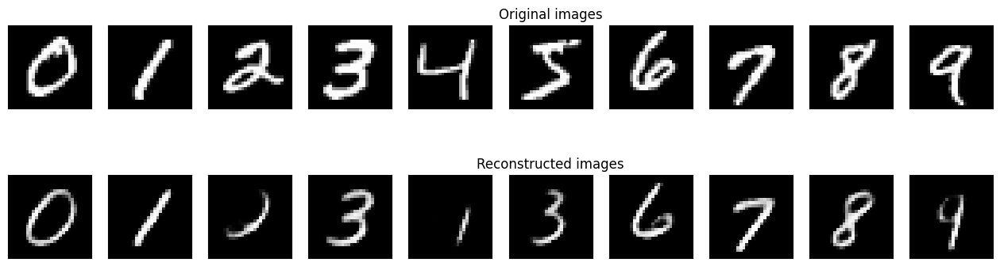

	 partial train loss (single batch): 22371.453125
	 partial train loss (single batch): 22587.492188
	 partial train loss (single batch): 22487.150391
	 partial train loss (single batch): 22336.955078
	 partial train loss (single batch): 22428.357422
	 partial train loss (single batch): 22480.365234
	 partial train loss (single batch): 22401.892578
	 partial train loss (single batch): 22313.679688
	 partial train loss (single batch): 22328.335938
	 partial train loss (single batch): 22280.466797
	 partial train loss (single batch): 22326.603516
	 partial train loss (single batch): 22448.964844
	 partial train loss (single batch): 22380.460938
	 partial train loss (single batch): 22358.183594
	 partial train loss (single batch): 22436.412109
	 partial train loss (single batch): 22120.222656
	 partial train loss (single batch): 22664.046875
	 partial train loss (single batch): 22292.365234
	 partial train loss (single batch): 22401.546875
	 partial train loss (single batch): 22073.492188


<Figure size 640x480 with 0 Axes>

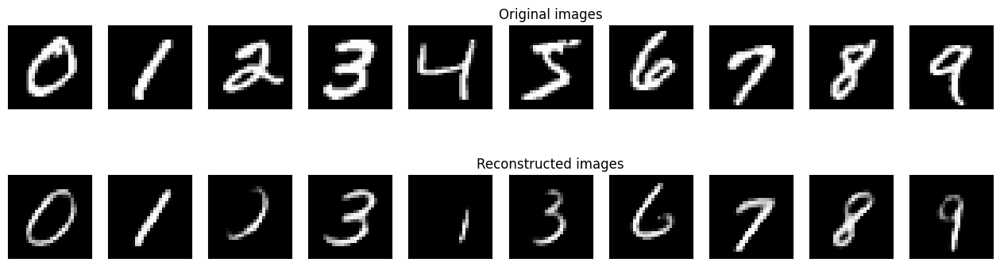

	 partial train loss (single batch): 22371.710938
	 partial train loss (single batch): 22576.046875
	 partial train loss (single batch): 22455.121094
	 partial train loss (single batch): 22347.484375
	 partial train loss (single batch): 22424.089844
	 partial train loss (single batch): 22470.937500
	 partial train loss (single batch): 22361.562500
	 partial train loss (single batch): 22352.994141
	 partial train loss (single batch): 22317.287109
	 partial train loss (single batch): 22243.027344
	 partial train loss (single batch): 22298.107422
	 partial train loss (single batch): 22464.789062
	 partial train loss (single batch): 22373.068359
	 partial train loss (single batch): 22359.472656
	 partial train loss (single batch): 22415.640625
	 partial train loss (single batch): 22113.005859
	 partial train loss (single batch): 22660.693359
	 partial train loss (single batch): 22276.242188
	 partial train loss (single batch): 22435.154297
	 partial train loss (single batch): 22101.183594


<Figure size 640x480 with 0 Axes>

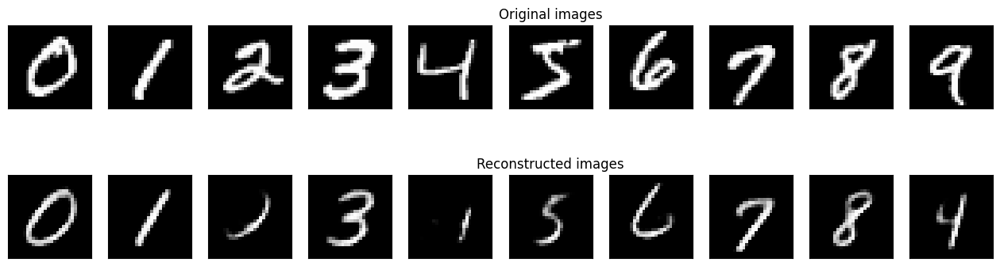

	 partial train loss (single batch): 22378.687500
	 partial train loss (single batch): 22578.183594
	 partial train loss (single batch): 22482.292969
	 partial train loss (single batch): 22367.732422
	 partial train loss (single batch): 22444.523438
	 partial train loss (single batch): 22488.269531
	 partial train loss (single batch): 22383.576172
	 partial train loss (single batch): 22363.917969
	 partial train loss (single batch): 22329.900391
	 partial train loss (single batch): 22255.705078
	 partial train loss (single batch): 22324.035156
	 partial train loss (single batch): 22452.162109
	 partial train loss (single batch): 22372.250000
	 partial train loss (single batch): 22363.416016
	 partial train loss (single batch): 22475.345703
	 partial train loss (single batch): 22110.587891
	 partial train loss (single batch): 22689.806641
	 partial train loss (single batch): 22252.267578
	 partial train loss (single batch): 22389.683594
	 partial train loss (single batch): 22054.650391


<Figure size 640x480 with 0 Axes>

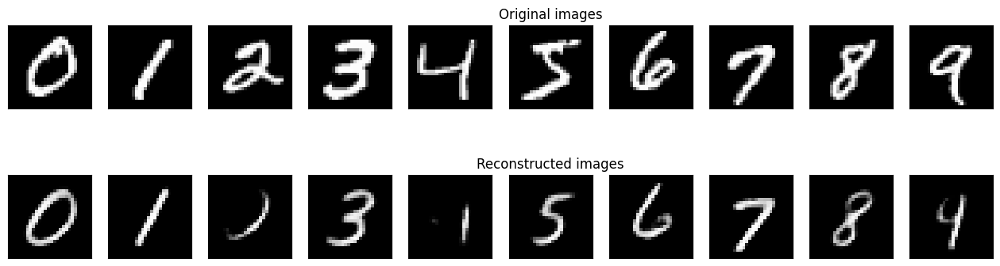

	 partial train loss (single batch): 22364.376953
	 partial train loss (single batch): 22564.373047
	 partial train loss (single batch): 22454.281250
	 partial train loss (single batch): 22368.541016
	 partial train loss (single batch): 22413.779297
	 partial train loss (single batch): 22501.939453
	 partial train loss (single batch): 22389.373047
	 partial train loss (single batch): 22330.621094
	 partial train loss (single batch): 22331.835938
	 partial train loss (single batch): 22278.964844
	 partial train loss (single batch): 22344.900391
	 partial train loss (single batch): 22447.523438
	 partial train loss (single batch): 22427.380859
	 partial train loss (single batch): 22376.746094
	 partial train loss (single batch): 22410.621094
	 partial train loss (single batch): 22096.332031
	 partial train loss (single batch): 22696.603516
	 partial train loss (single batch): 22260.037109
	 partial train loss (single batch): 22365.572266
	 partial train loss (single batch): 22068.039062


<Figure size 640x480 with 0 Axes>

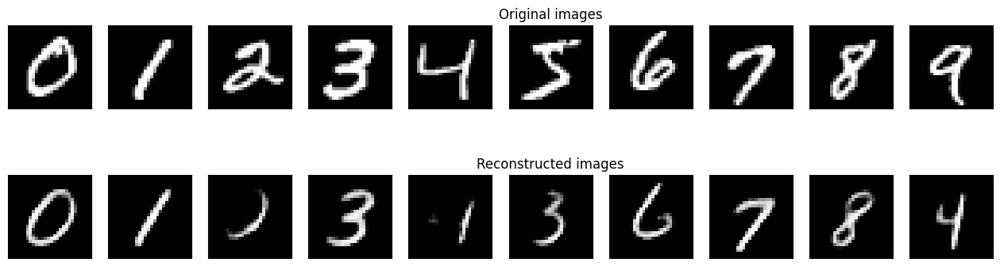

	 partial train loss (single batch): 22364.316406
	 partial train loss (single batch): 22576.560547
	 partial train loss (single batch): 22476.164062
	 partial train loss (single batch): 22358.345703
	 partial train loss (single batch): 22432.744141
	 partial train loss (single batch): 22506.150391
	 partial train loss (single batch): 22399.308594
	 partial train loss (single batch): 22338.800781
	 partial train loss (single batch): 22349.144531
	 partial train loss (single batch): 22268.128906
	 partial train loss (single batch): 22356.142578
	 partial train loss (single batch): 22465.742188
	 partial train loss (single batch): 22390.166016
	 partial train loss (single batch): 22361.781250
	 partial train loss (single batch): 22406.107422
	 partial train loss (single batch): 22143.916016
	 partial train loss (single batch): 22670.232422
	 partial train loss (single batch): 22263.833984
	 partial train loss (single batch): 22391.509766
	 partial train loss (single batch): 22056.376953


<Figure size 640x480 with 0 Axes>

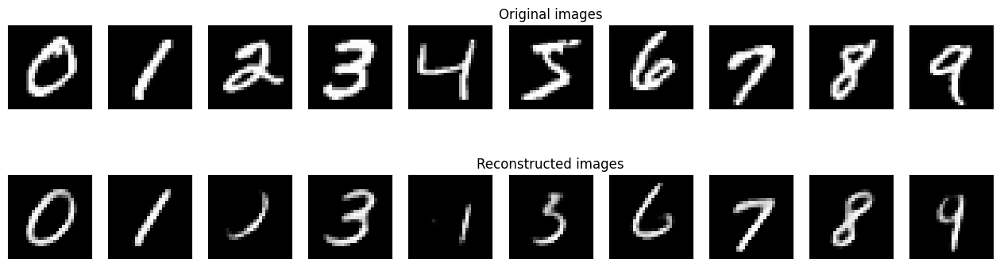

	 partial train loss (single batch): 22369.000000
	 partial train loss (single batch): 22561.289062
	 partial train loss (single batch): 22506.470703
	 partial train loss (single batch): 22342.263672
	 partial train loss (single batch): 22450.517578
	 partial train loss (single batch): 22516.625000
	 partial train loss (single batch): 22362.320312
	 partial train loss (single batch): 22346.589844
	 partial train loss (single batch): 22321.832031
	 partial train loss (single batch): 22277.570312
	 partial train loss (single batch): 22324.375000
	 partial train loss (single batch): 22464.685547
	 partial train loss (single batch): 22397.267578
	 partial train loss (single batch): 22379.275391
	 partial train loss (single batch): 22431.318359
	 partial train loss (single batch): 22157.388672
	 partial train loss (single batch): 22673.923828
	 partial train loss (single batch): 22278.851562
	 partial train loss (single batch): 22390.962891
	 partial train loss (single batch): 22044.564453


<Figure size 640x480 with 0 Axes>

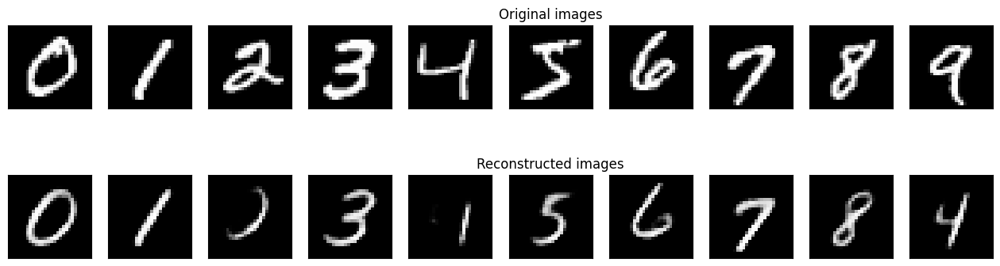

	 partial train loss (single batch): 22332.445312
	 partial train loss (single batch): 22593.726562
	 partial train loss (single batch): 22507.572266
	 partial train loss (single batch): 22350.718750
	 partial train loss (single batch): 22428.318359
	 partial train loss (single batch): 22464.107422
	 partial train loss (single batch): 22386.029297
	 partial train loss (single batch): 22307.554688
	 partial train loss (single batch): 22337.748047
	 partial train loss (single batch): 22263.273438
	 partial train loss (single batch): 22292.673828
	 partial train loss (single batch): 22434.236328
	 partial train loss (single batch): 22412.470703
	 partial train loss (single batch): 22364.845703
	 partial train loss (single batch): 22411.417969
	 partial train loss (single batch): 22109.263672
	 partial train loss (single batch): 22657.521484
	 partial train loss (single batch): 22255.675781
	 partial train loss (single batch): 22394.431641
	 partial train loss (single batch): 22052.044922


<Figure size 640x480 with 0 Axes>

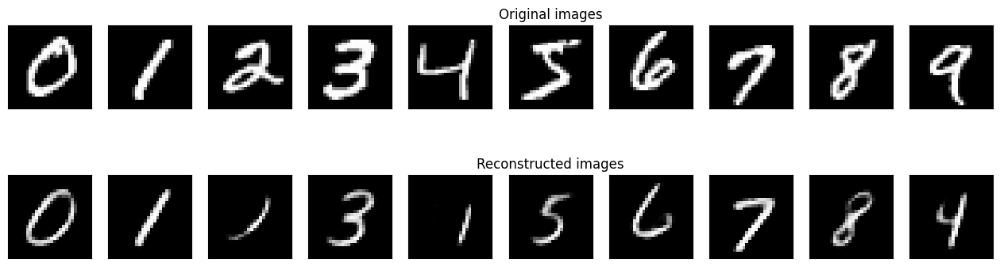

	 partial train loss (single batch): 22399.435547
	 partial train loss (single batch): 22580.341797
	 partial train loss (single batch): 22435.277344
	 partial train loss (single batch): 22390.367188
	 partial train loss (single batch): 22385.951172
	 partial train loss (single batch): 22507.484375
	 partial train loss (single batch): 22422.320312
	 partial train loss (single batch): 22335.052734
	 partial train loss (single batch): 22338.595703
	 partial train loss (single batch): 22243.289062
	 partial train loss (single batch): 22353.470703
	 partial train loss (single batch): 22484.623047
	 partial train loss (single batch): 22381.978516
	 partial train loss (single batch): 22371.955078
	 partial train loss (single batch): 22402.003906
	 partial train loss (single batch): 22120.375000
	 partial train loss (single batch): 22692.564453
	 partial train loss (single batch): 22293.843750
	 partial train loss (single batch): 22382.908203
	 partial train loss (single batch): 22023.796875


<Figure size 640x480 with 0 Axes>

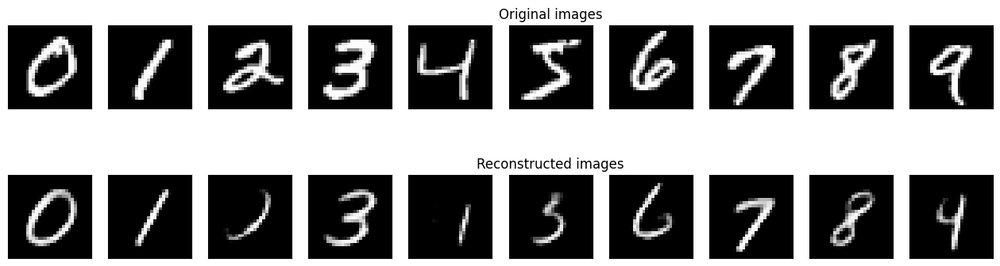

	 partial train loss (single batch): 22341.142578
	 partial train loss (single batch): 22583.748047
	 partial train loss (single batch): 22458.490234
	 partial train loss (single batch): 22376.917969
	 partial train loss (single batch): 22420.207031
	 partial train loss (single batch): 22506.552734
	 partial train loss (single batch): 22365.185547
	 partial train loss (single batch): 22319.191406
	 partial train loss (single batch): 22315.277344
	 partial train loss (single batch): 22248.980469
	 partial train loss (single batch): 22361.548828
	 partial train loss (single batch): 22442.470703
	 partial train loss (single batch): 22388.529297
	 partial train loss (single batch): 22362.992188
	 partial train loss (single batch): 22441.498047
	 partial train loss (single batch): 22129.648438
	 partial train loss (single batch): 22670.203125
	 partial train loss (single batch): 22260.990234
	 partial train loss (single batch): 22417.562500
	 partial train loss (single batch): 22064.388672


<Figure size 640x480 with 0 Axes>

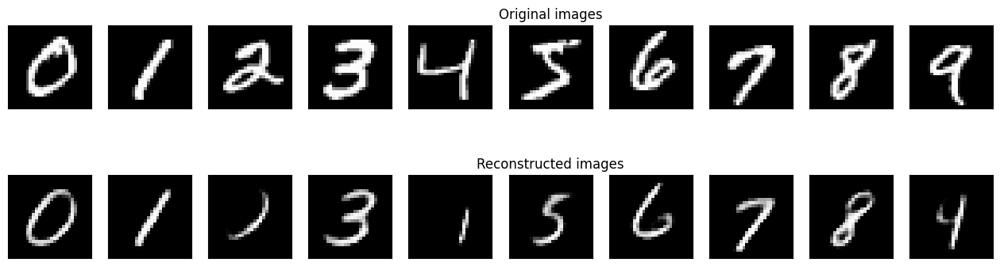

	 partial train loss (single batch): 22347.410156
	 partial train loss (single batch): 22579.753906
	 partial train loss (single batch): 22476.574219
	 partial train loss (single batch): 22364.140625
	 partial train loss (single batch): 22415.689453
	 partial train loss (single batch): 22509.921875
	 partial train loss (single batch): 22412.728516
	 partial train loss (single batch): 22336.591797
	 partial train loss (single batch): 22341.689453
	 partial train loss (single batch): 22250.830078
	 partial train loss (single batch): 22371.207031
	 partial train loss (single batch): 22479.796875
	 partial train loss (single batch): 22373.007812
	 partial train loss (single batch): 22376.607422
	 partial train loss (single batch): 22435.603516
	 partial train loss (single batch): 22136.683594
	 partial train loss (single batch): 22693.447266
	 partial train loss (single batch): 22266.326172
	 partial train loss (single batch): 22375.236328
	 partial train loss (single batch): 22072.615234


<Figure size 640x480 with 0 Axes>

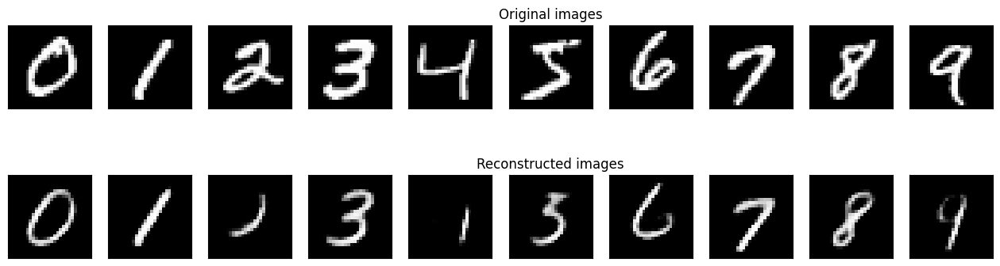

	 partial train loss (single batch): 22323.269531
	 partial train loss (single batch): 22554.041016
	 partial train loss (single batch): 22487.435547
	 partial train loss (single batch): 22345.527344
	 partial train loss (single batch): 22429.064453
	 partial train loss (single batch): 22509.607422
	 partial train loss (single batch): 22376.898438
	 partial train loss (single batch): 22325.738281
	 partial train loss (single batch): 22329.072266
	 partial train loss (single batch): 22252.476562
	 partial train loss (single batch): 22339.716797
	 partial train loss (single batch): 22408.804688
	 partial train loss (single batch): 22372.105469
	 partial train loss (single batch): 22331.287109
	 partial train loss (single batch): 22411.794922
	 partial train loss (single batch): 22144.855469
	 partial train loss (single batch): 22671.867188
	 partial train loss (single batch): 22284.734375
	 partial train loss (single batch): 22374.460938
	 partial train loss (single batch): 22095.964844


<Figure size 640x480 with 0 Axes>

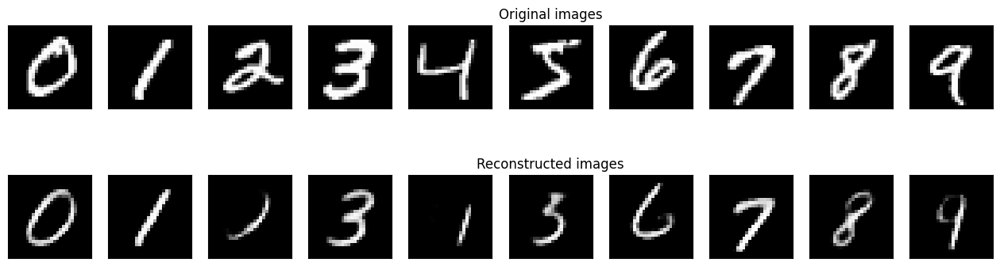

	 partial train loss (single batch): 22372.027344
	 partial train loss (single batch): 22569.488281
	 partial train loss (single batch): 22461.468750
	 partial train loss (single batch): 22366.265625
	 partial train loss (single batch): 22426.316406
	 partial train loss (single batch): 22490.242188
	 partial train loss (single batch): 22404.548828
	 partial train loss (single batch): 22342.517578
	 partial train loss (single batch): 22337.638672
	 partial train loss (single batch): 22251.011719
	 partial train loss (single batch): 22360.718750
	 partial train loss (single batch): 22438.500000
	 partial train loss (single batch): 22378.250000
	 partial train loss (single batch): 22360.150391
	 partial train loss (single batch): 22441.593750
	 partial train loss (single batch): 22116.341797
	 partial train loss (single batch): 22657.191406
	 partial train loss (single batch): 22273.589844
	 partial train loss (single batch): 22398.703125
	 partial train loss (single batch): 22040.066406


<Figure size 640x480 with 0 Axes>

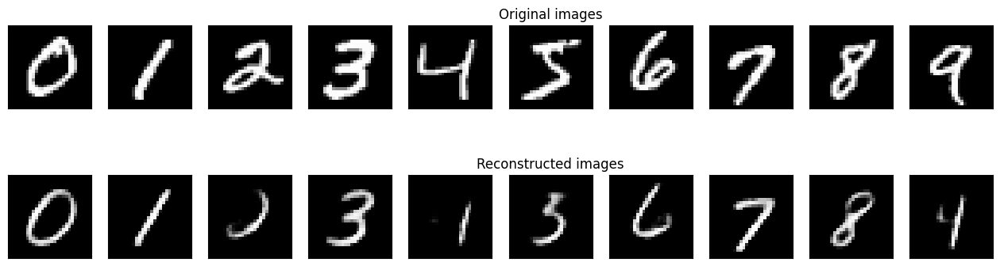

	 partial train loss (single batch): 22345.962891
	 partial train loss (single batch): 22587.121094
	 partial train loss (single batch): 22476.941406
	 partial train loss (single batch): 22375.023438
	 partial train loss (single batch): 22428.730469
	 partial train loss (single batch): 22482.431641
	 partial train loss (single batch): 22397.173828
	 partial train loss (single batch): 22309.683594
	 partial train loss (single batch): 22340.332031
	 partial train loss (single batch): 22223.119141
	 partial train loss (single batch): 22302.246094
	 partial train loss (single batch): 22450.923828
	 partial train loss (single batch): 22377.712891
	 partial train loss (single batch): 22361.125000
	 partial train loss (single batch): 22446.062500
	 partial train loss (single batch): 22164.261719
	 partial train loss (single batch): 22672.380859
	 partial train loss (single batch): 22300.878906
	 partial train loss (single batch): 22411.199219
	 partial train loss (single batch): 22040.884766


<Figure size 640x480 with 0 Axes>

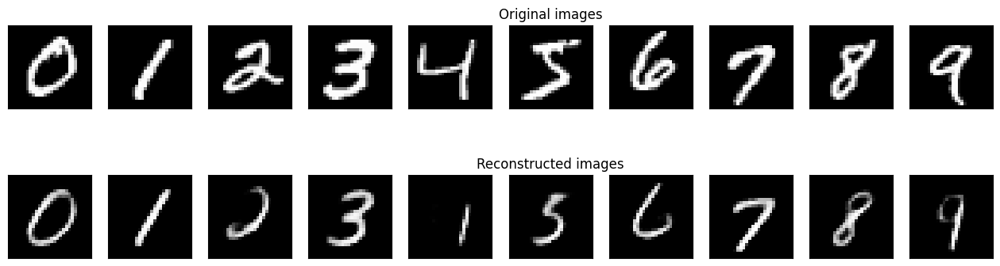

	 partial train loss (single batch): 22378.269531
	 partial train loss (single batch): 22594.462891
	 partial train loss (single batch): 22484.248047
	 partial train loss (single batch): 22336.312500
	 partial train loss (single batch): 22468.289062
	 partial train loss (single batch): 22495.460938
	 partial train loss (single batch): 22391.685547
	 partial train loss (single batch): 22307.052734
	 partial train loss (single batch): 22310.876953
	 partial train loss (single batch): 22244.302734
	 partial train loss (single batch): 22343.490234
	 partial train loss (single batch): 22436.832031
	 partial train loss (single batch): 22353.287109
	 partial train loss (single batch): 22373.677734
	 partial train loss (single batch): 22414.478516
	 partial train loss (single batch): 22144.121094
	 partial train loss (single batch): 22680.498047
	 partial train loss (single batch): 22260.123047
	 partial train loss (single batch): 22401.574219
	 partial train loss (single batch): 22041.402344


<Figure size 640x480 with 0 Axes>

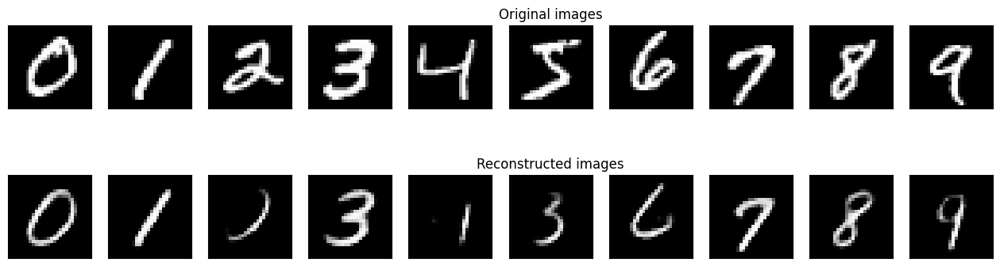

	 partial train loss (single batch): 22345.945312
	 partial train loss (single batch): 22600.800781
	 partial train loss (single batch): 22473.425781
	 partial train loss (single batch): 22388.601562
	 partial train loss (single batch): 22444.892578
	 partial train loss (single batch): 22486.779297
	 partial train loss (single batch): 22405.568359
	 partial train loss (single batch): 22320.845703
	 partial train loss (single batch): 22309.044922
	 partial train loss (single batch): 22265.441406
	 partial train loss (single batch): 22341.421875
	 partial train loss (single batch): 22413.472656
	 partial train loss (single batch): 22376.333984
	 partial train loss (single batch): 22329.796875
	 partial train loss (single batch): 22426.412109
	 partial train loss (single batch): 22130.369141
	 partial train loss (single batch): 22685.152344
	 partial train loss (single batch): 22270.589844
	 partial train loss (single batch): 22399.769531
	 partial train loss (single batch): 22065.365234


<Figure size 640x480 with 0 Axes>

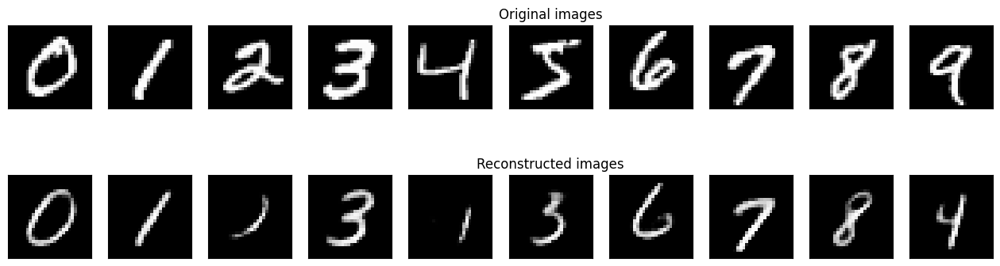

	 partial train loss (single batch): 22341.169922
	 partial train loss (single batch): 22525.996094
	 partial train loss (single batch): 22493.779297
	 partial train loss (single batch): 22346.214844
	 partial train loss (single batch): 22467.757812
	 partial train loss (single batch): 22471.994141
	 partial train loss (single batch): 22403.246094
	 partial train loss (single batch): 22293.804688
	 partial train loss (single batch): 22308.675781
	 partial train loss (single batch): 22236.310547
	 partial train loss (single batch): 22322.537109
	 partial train loss (single batch): 22452.783203
	 partial train loss (single batch): 22375.802734
	 partial train loss (single batch): 22363.476562
	 partial train loss (single batch): 22417.166016
	 partial train loss (single batch): 22135.597656
	 partial train loss (single batch): 22689.882812
	 partial train loss (single batch): 22300.605469
	 partial train loss (single batch): 22406.013672
	 partial train loss (single batch): 22046.626953


<Figure size 640x480 with 0 Axes>

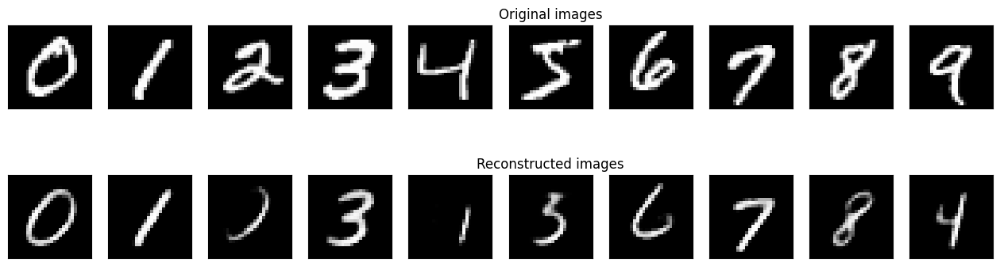

	 partial train loss (single batch): 22364.199219
	 partial train loss (single batch): 22566.619141
	 partial train loss (single batch): 22492.816406
	 partial train loss (single batch): 22388.722656
	 partial train loss (single batch): 22428.662109
	 partial train loss (single batch): 22475.488281
	 partial train loss (single batch): 22367.724609
	 partial train loss (single batch): 22311.414062
	 partial train loss (single batch): 22349.212891
	 partial train loss (single batch): 22257.705078
	 partial train loss (single batch): 22327.521484
	 partial train loss (single batch): 22442.234375
	 partial train loss (single batch): 22395.134766
	 partial train loss (single batch): 22370.558594
	 partial train loss (single batch): 22412.044922
	 partial train loss (single batch): 22131.761719
	 partial train loss (single batch): 22688.478516
	 partial train loss (single batch): 22298.832031
	 partial train loss (single batch): 22414.703125
	 partial train loss (single batch): 22067.785156


<Figure size 640x480 with 0 Axes>

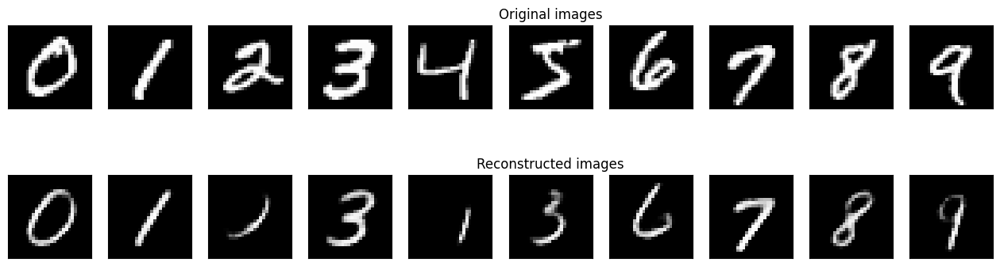

	 partial train loss (single batch): 22346.210938
	 partial train loss (single batch): 22558.283203
	 partial train loss (single batch): 22460.830078
	 partial train loss (single batch): 22339.732422
	 partial train loss (single batch): 22433.345703
	 partial train loss (single batch): 22502.027344
	 partial train loss (single batch): 22374.521484
	 partial train loss (single batch): 22290.167969
	 partial train loss (single batch): 22318.992188
	 partial train loss (single batch): 22241.318359
	 partial train loss (single batch): 22343.269531
	 partial train loss (single batch): 22430.554688
	 partial train loss (single batch): 22352.980469
	 partial train loss (single batch): 22369.226562
	 partial train loss (single batch): 22397.873047
	 partial train loss (single batch): 22124.472656
	 partial train loss (single batch): 22690.876953
	 partial train loss (single batch): 22247.414062
	 partial train loss (single batch): 22398.310547
	 partial train loss (single batch): 22026.167969


<Figure size 640x480 with 0 Axes>

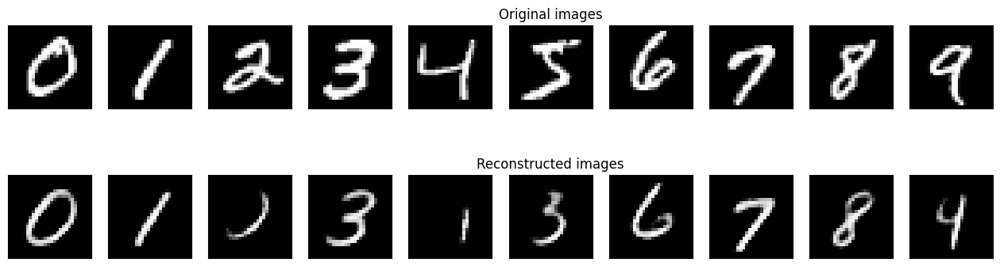

	 partial train loss (single batch): 22344.232422
	 partial train loss (single batch): 22542.769531
	 partial train loss (single batch): 22465.859375
	 partial train loss (single batch): 22363.765625
	 partial train loss (single batch): 22454.767578
	 partial train loss (single batch): 22490.097656
	 partial train loss (single batch): 22375.343750
	 partial train loss (single batch): 22300.080078
	 partial train loss (single batch): 22330.632812
	 partial train loss (single batch): 22241.107422
	 partial train loss (single batch): 22309.746094
	 partial train loss (single batch): 22451.335938
	 partial train loss (single batch): 22338.876953
	 partial train loss (single batch): 22367.292969
	 partial train loss (single batch): 22426.984375
	 partial train loss (single batch): 22128.427734
	 partial train loss (single batch): 22673.857422
	 partial train loss (single batch): 22241.292969
	 partial train loss (single batch): 22390.843750
	 partial train loss (single batch): 22056.505859


<Figure size 640x480 with 0 Axes>

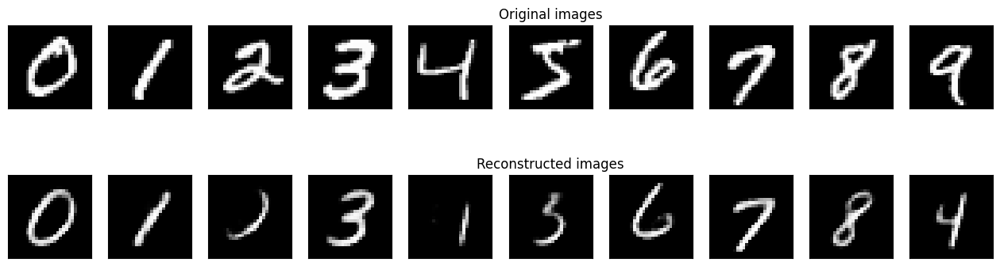

	 partial train loss (single batch): 22350.560547
	 partial train loss (single batch): 22556.326172
	 partial train loss (single batch): 22480.458984
	 partial train loss (single batch): 22364.857422
	 partial train loss (single batch): 22430.767578
	 partial train loss (single batch): 22491.390625
	 partial train loss (single batch): 22359.433594
	 partial train loss (single batch): 22312.703125
	 partial train loss (single batch): 22317.144531
	 partial train loss (single batch): 22260.689453
	 partial train loss (single batch): 22312.529297
	 partial train loss (single batch): 22483.580078
	 partial train loss (single batch): 22389.126953
	 partial train loss (single batch): 22336.439453
	 partial train loss (single batch): 22425.630859
	 partial train loss (single batch): 22122.076172
	 partial train loss (single batch): 22681.095703
	 partial train loss (single batch): 22251.882812
	 partial train loss (single batch): 22417.681641
	 partial train loss (single batch): 22038.531250


<Figure size 640x480 with 0 Axes>

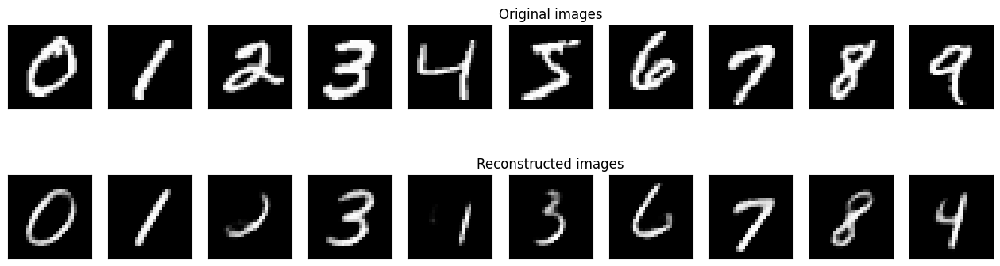

	 partial train loss (single batch): 22344.250000
	 partial train loss (single batch): 22541.130859
	 partial train loss (single batch): 22497.371094
	 partial train loss (single batch): 22396.832031
	 partial train loss (single batch): 22442.031250
	 partial train loss (single batch): 22475.236328
	 partial train loss (single batch): 22358.289062
	 partial train loss (single batch): 22339.027344
	 partial train loss (single batch): 22317.660156
	 partial train loss (single batch): 22248.828125
	 partial train loss (single batch): 22358.380859
	 partial train loss (single batch): 22478.445312
	 partial train loss (single batch): 22382.617188
	 partial train loss (single batch): 22375.830078
	 partial train loss (single batch): 22450.488281
	 partial train loss (single batch): 22119.404297
	 partial train loss (single batch): 22688.558594
	 partial train loss (single batch): 22260.119141
	 partial train loss (single batch): 22375.347656
	 partial train loss (single batch): 22039.324219


<Figure size 640x480 with 0 Axes>

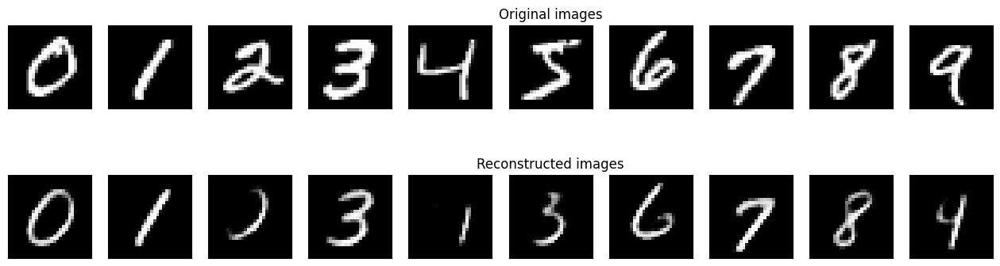

	 partial train loss (single batch): 22332.052734
	 partial train loss (single batch): 22571.382812
	 partial train loss (single batch): 22520.296875
	 partial train loss (single batch): 22382.882812
	 partial train loss (single batch): 22454.246094
	 partial train loss (single batch): 22464.630859
	 partial train loss (single batch): 22358.724609
	 partial train loss (single batch): 22305.265625
	 partial train loss (single batch): 22285.046875
	 partial train loss (single batch): 22258.699219
	 partial train loss (single batch): 22317.855469
	 partial train loss (single batch): 22444.091797
	 partial train loss (single batch): 22365.494141
	 partial train loss (single batch): 22360.935547
	 partial train loss (single batch): 22405.931641
	 partial train loss (single batch): 22135.046875
	 partial train loss (single batch): 22676.574219
	 partial train loss (single batch): 22254.222656
	 partial train loss (single batch): 22404.556641
	 partial train loss (single batch): 22065.335938


<Figure size 640x480 with 0 Axes>

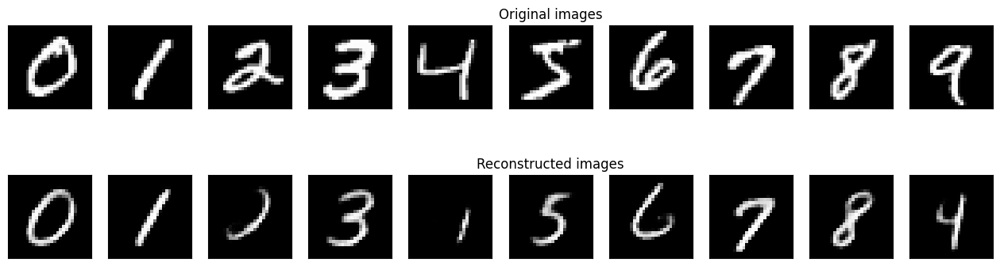

	 partial train loss (single batch): 22362.673828
	 partial train loss (single batch): 22571.511719
	 partial train loss (single batch): 22495.759766
	 partial train loss (single batch): 22369.435547
	 partial train loss (single batch): 22477.253906
	 partial train loss (single batch): 22467.455078
	 partial train loss (single batch): 22424.767578
	 partial train loss (single batch): 22289.431641
	 partial train loss (single batch): 22323.439453
	 partial train loss (single batch): 22253.001953
	 partial train loss (single batch): 22338.509766
	 partial train loss (single batch): 22465.775391
	 partial train loss (single batch): 22368.675781
	 partial train loss (single batch): 22360.693359
	 partial train loss (single batch): 22388.701172
	 partial train loss (single batch): 22117.384766
	 partial train loss (single batch): 22675.007812
	 partial train loss (single batch): 22250.136719
	 partial train loss (single batch): 22393.994141
	 partial train loss (single batch): 22037.908203


<Figure size 640x480 with 0 Axes>

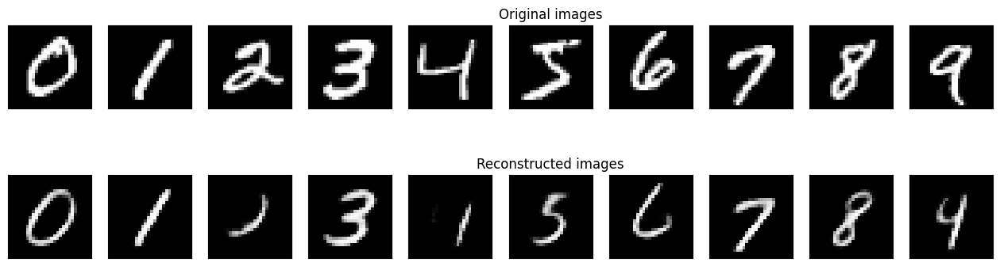

	 partial train loss (single batch): 22358.228516
	 partial train loss (single batch): 22584.447266
	 partial train loss (single batch): 22458.384766
	 partial train loss (single batch): 22374.412109
	 partial train loss (single batch): 22413.273438
	 partial train loss (single batch): 22495.347656
	 partial train loss (single batch): 22361.562500
	 partial train loss (single batch): 22271.986328
	 partial train loss (single batch): 22344.175781
	 partial train loss (single batch): 22229.914062
	 partial train loss (single batch): 22333.822266
	 partial train loss (single batch): 22403.626953
	 partial train loss (single batch): 22380.648438
	 partial train loss (single batch): 22342.740234
	 partial train loss (single batch): 22415.382812
	 partial train loss (single batch): 22128.890625
	 partial train loss (single batch): 22659.070312
	 partial train loss (single batch): 22283.474609
	 partial train loss (single batch): 22416.966797
	 partial train loss (single batch): 22043.972656


<Figure size 640x480 with 0 Axes>

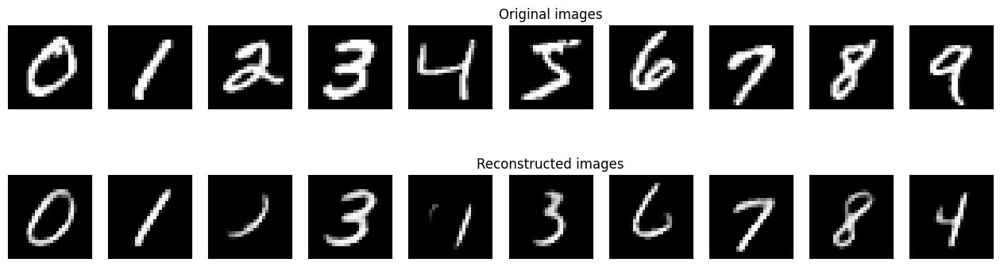

	 partial train loss (single batch): 22363.708984
	 partial train loss (single batch): 22543.121094
	 partial train loss (single batch): 22477.833984
	 partial train loss (single batch): 22388.619141
	 partial train loss (single batch): 22402.453125
	 partial train loss (single batch): 22506.894531
	 partial train loss (single batch): 22390.269531
	 partial train loss (single batch): 22333.031250
	 partial train loss (single batch): 22356.126953
	 partial train loss (single batch): 22223.152344
	 partial train loss (single batch): 22321.332031
	 partial train loss (single batch): 22449.207031
	 partial train loss (single batch): 22379.548828
	 partial train loss (single batch): 22315.072266
	 partial train loss (single batch): 22402.388672
	 partial train loss (single batch): 22101.498047
	 partial train loss (single batch): 22687.189453
	 partial train loss (single batch): 22240.929688
	 partial train loss (single batch): 22416.722656
	 partial train loss (single batch): 22058.152344


<Figure size 640x480 with 0 Axes>

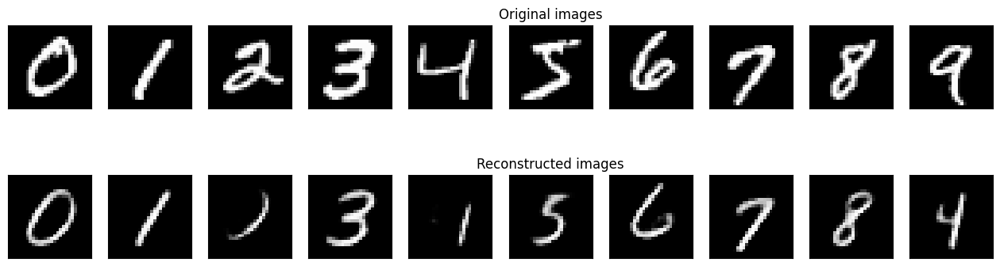

	 partial train loss (single batch): 22352.978516
	 partial train loss (single batch): 22569.343750
	 partial train loss (single batch): 22491.296875
	 partial train loss (single batch): 22385.210938
	 partial train loss (single batch): 22431.826172
	 partial train loss (single batch): 22502.433594
	 partial train loss (single batch): 22352.927734
	 partial train loss (single batch): 22303.248047
	 partial train loss (single batch): 22324.671875
	 partial train loss (single batch): 22239.351562
	 partial train loss (single batch): 22330.392578
	 partial train loss (single batch): 22464.142578
	 partial train loss (single batch): 22401.427734
	 partial train loss (single batch): 22359.810547
	 partial train loss (single batch): 22374.203125
	 partial train loss (single batch): 22082.835938
	 partial train loss (single batch): 22697.117188
	 partial train loss (single batch): 22247.212891
	 partial train loss (single batch): 22422.570312
	 partial train loss (single batch): 22070.330078


<Figure size 640x480 with 0 Axes>

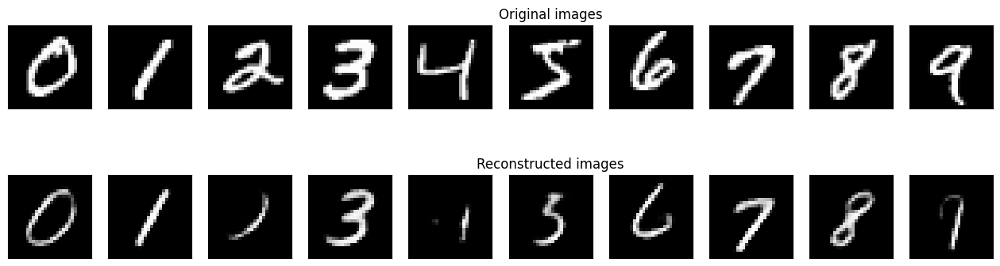

	 partial train loss (single batch): 22340.564453
	 partial train loss (single batch): 22573.320312
	 partial train loss (single batch): 22477.285156
	 partial train loss (single batch): 22402.648438
	 partial train loss (single batch): 22399.507812
	 partial train loss (single batch): 22518.035156
	 partial train loss (single batch): 22389.294922
	 partial train loss (single batch): 22325.396484
	 partial train loss (single batch): 22350.177734
	 partial train loss (single batch): 22265.642578
	 partial train loss (single batch): 22312.742188
	 partial train loss (single batch): 22399.390625
	 partial train loss (single batch): 22393.955078
	 partial train loss (single batch): 22345.705078
	 partial train loss (single batch): 22436.144531
	 partial train loss (single batch): 22114.320312
	 partial train loss (single batch): 22665.769531
	 partial train loss (single batch): 22256.519531
	 partial train loss (single batch): 22375.664062
	 partial train loss (single batch): 22031.740234


<Figure size 640x480 with 0 Axes>

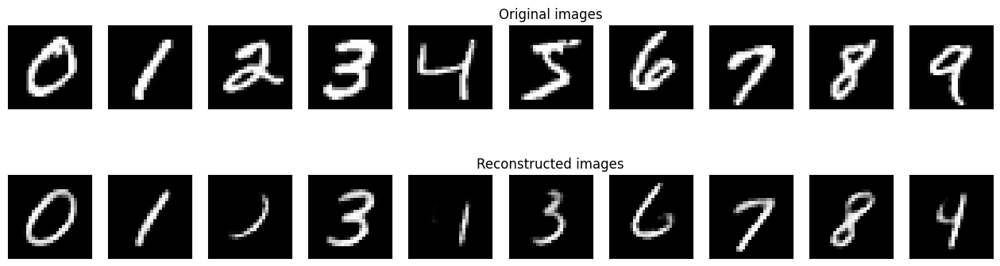

	 partial train loss (single batch): 22383.275391
	 partial train loss (single batch): 22546.349609
	 partial train loss (single batch): 22468.179688
	 partial train loss (single batch): 22347.050781
	 partial train loss (single batch): 22426.044922
	 partial train loss (single batch): 22470.068359
	 partial train loss (single batch): 22429.828125
	 partial train loss (single batch): 22330.195312
	 partial train loss (single batch): 22327.679688
	 partial train loss (single batch): 22227.015625
	 partial train loss (single batch): 22296.675781
	 partial train loss (single batch): 22407.976562
	 partial train loss (single batch): 22358.439453
	 partial train loss (single batch): 22317.906250
	 partial train loss (single batch): 22397.511719
	 partial train loss (single batch): 22111.621094
	 partial train loss (single batch): 22680.800781
	 partial train loss (single batch): 22260.775391
	 partial train loss (single batch): 22388.656250
	 partial train loss (single batch): 22039.517578


<Figure size 640x480 with 0 Axes>

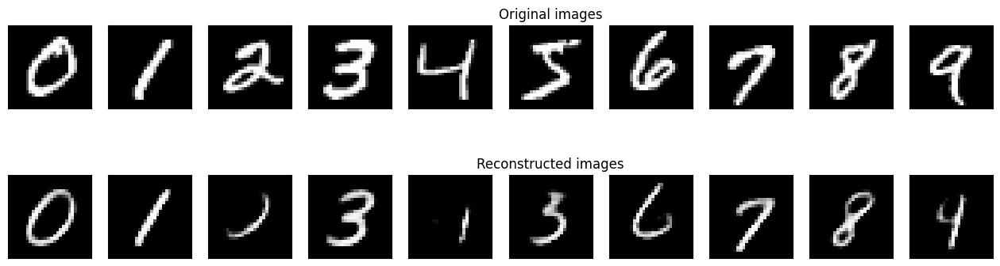

	 partial train loss (single batch): 22357.039062
	 partial train loss (single batch): 22572.326172
	 partial train loss (single batch): 22497.130859
	 partial train loss (single batch): 22421.873047
	 partial train loss (single batch): 22400.992188
	 partial train loss (single batch): 22496.527344
	 partial train loss (single batch): 22425.562500
	 partial train loss (single batch): 22332.697266
	 partial train loss (single batch): 22310.556641
	 partial train loss (single batch): 22259.271484
	 partial train loss (single batch): 22322.773438
	 partial train loss (single batch): 22466.447266
	 partial train loss (single batch): 22348.496094
	 partial train loss (single batch): 22353.123047
	 partial train loss (single batch): 22413.873047
	 partial train loss (single batch): 22119.791016
	 partial train loss (single batch): 22656.685547
	 partial train loss (single batch): 22283.029297
	 partial train loss (single batch): 22410.972656
	 partial train loss (single batch): 22025.578125


<Figure size 640x480 with 0 Axes>

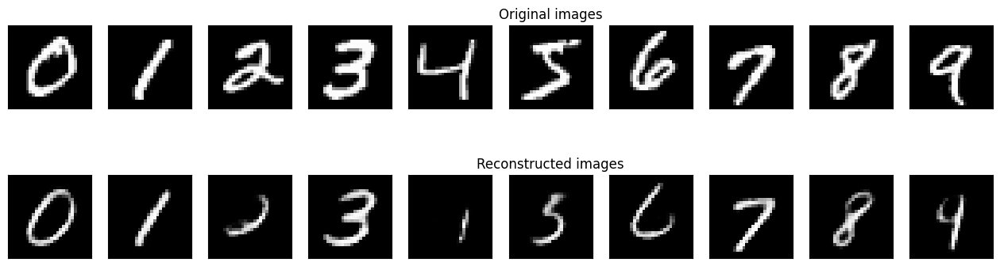

	 partial train loss (single batch): 22343.542969
	 partial train loss (single batch): 22546.636719
	 partial train loss (single batch): 22465.394531
	 partial train loss (single batch): 22347.511719
	 partial train loss (single batch): 22411.154297
	 partial train loss (single batch): 22489.107422
	 partial train loss (single batch): 22382.439453
	 partial train loss (single batch): 22323.876953
	 partial train loss (single batch): 22329.570312
	 partial train loss (single batch): 22240.119141
	 partial train loss (single batch): 22306.150391
	 partial train loss (single batch): 22437.578125
	 partial train loss (single batch): 22367.248047
	 partial train loss (single batch): 22351.349609
	 partial train loss (single batch): 22396.419922
	 partial train loss (single batch): 22089.966797
	 partial train loss (single batch): 22657.271484
	 partial train loss (single batch): 22252.017578
	 partial train loss (single batch): 22351.933594
	 partial train loss (single batch): 22057.111328


<Figure size 640x480 with 0 Axes>

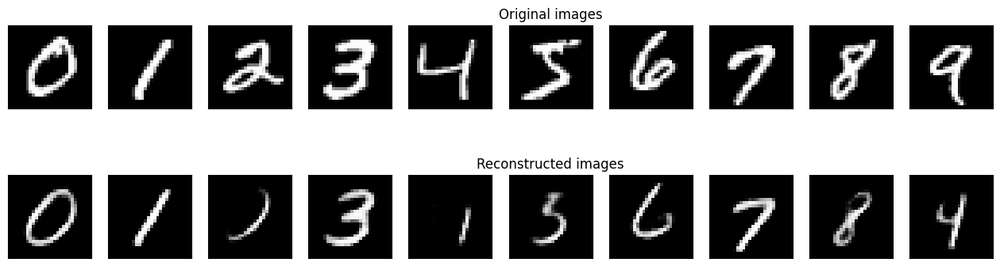

	 partial train loss (single batch): 22351.794922
	 partial train loss (single batch): 22567.593750
	 partial train loss (single batch): 22493.546875
	 partial train loss (single batch): 22397.974609
	 partial train loss (single batch): 22424.886719
	 partial train loss (single batch): 22485.654297
	 partial train loss (single batch): 22365.056641
	 partial train loss (single batch): 22305.458984
	 partial train loss (single batch): 22325.560547
	 partial train loss (single batch): 22277.705078
	 partial train loss (single batch): 22335.253906
	 partial train loss (single batch): 22458.652344
	 partial train loss (single batch): 22376.169922
	 partial train loss (single batch): 22312.933594
	 partial train loss (single batch): 22416.574219
	 partial train loss (single batch): 22130.357422
	 partial train loss (single batch): 22664.570312
	 partial train loss (single batch): 22234.738281
	 partial train loss (single batch): 22372.312500
	 partial train loss (single batch): 22028.337891


<Figure size 640x480 with 0 Axes>

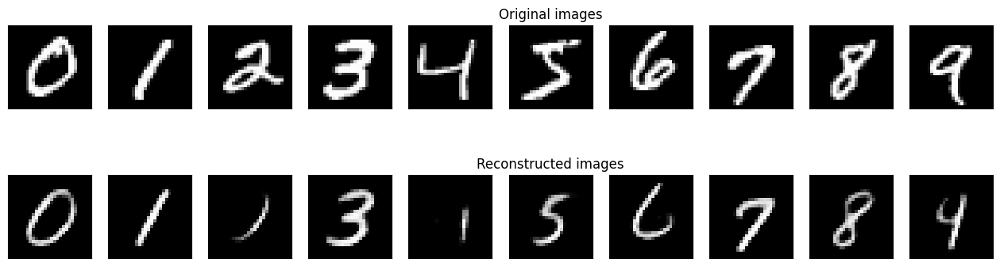

	 partial train loss (single batch): 22376.013672
	 partial train loss (single batch): 22573.318359
	 partial train loss (single batch): 22485.107422
	 partial train loss (single batch): 22389.312500
	 partial train loss (single batch): 22424.507812
	 partial train loss (single batch): 22478.492188
	 partial train loss (single batch): 22381.029297
	 partial train loss (single batch): 22294.945312
	 partial train loss (single batch): 22306.517578
	 partial train loss (single batch): 22241.716797
	 partial train loss (single batch): 22313.402344
	 partial train loss (single batch): 22439.669922
	 partial train loss (single batch): 22355.031250
	 partial train loss (single batch): 22331.908203
	 partial train loss (single batch): 22394.921875
	 partial train loss (single batch): 22097.619141
	 partial train loss (single batch): 22679.041016
	 partial train loss (single batch): 22264.320312
	 partial train loss (single batch): 22399.400391
	 partial train loss (single batch): 22025.382812


<Figure size 640x480 with 0 Axes>

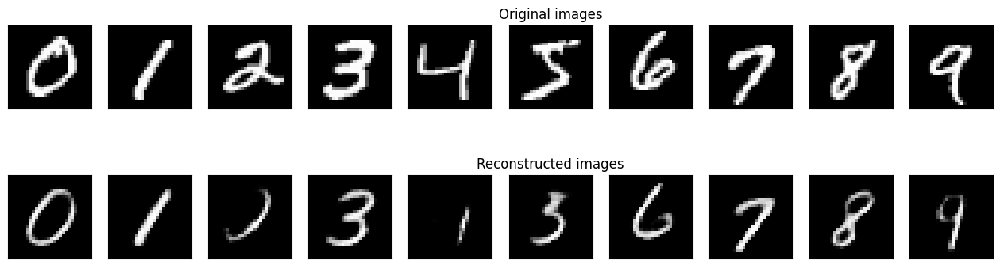

	 partial train loss (single batch): 22339.503906
	 partial train loss (single batch): 22616.828125
	 partial train loss (single batch): 22468.521484
	 partial train loss (single batch): 22353.207031
	 partial train loss (single batch): 22424.753906
	 partial train loss (single batch): 22490.273438
	 partial train loss (single batch): 22387.873047
	 partial train loss (single batch): 22277.482422
	 partial train loss (single batch): 22328.968750
	 partial train loss (single batch): 22256.246094
	 partial train loss (single batch): 22328.310547
	 partial train loss (single batch): 22401.556641
	 partial train loss (single batch): 22376.841797
	 partial train loss (single batch): 22370.732422
	 partial train loss (single batch): 22430.947266
	 partial train loss (single batch): 22112.755859
	 partial train loss (single batch): 22644.830078
	 partial train loss (single batch): 22248.425781
	 partial train loss (single batch): 22399.199219
	 partial train loss (single batch): 22079.142578


<Figure size 640x480 with 0 Axes>

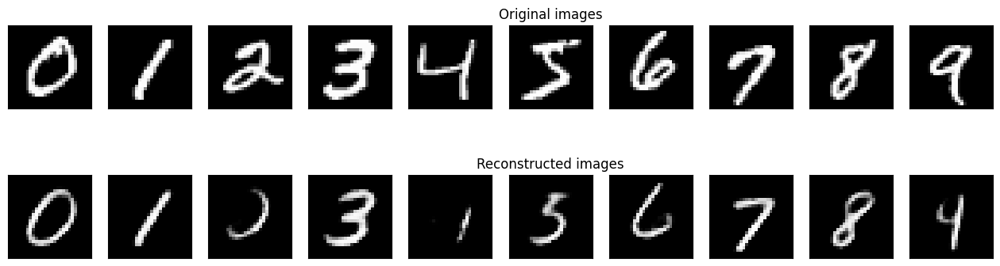

	 partial train loss (single batch): 22345.460938
	 partial train loss (single batch): 22573.093750
	 partial train loss (single batch): 22469.919922
	 partial train loss (single batch): 22368.644531
	 partial train loss (single batch): 22395.736328
	 partial train loss (single batch): 22459.755859
	 partial train loss (single batch): 22394.634766
	 partial train loss (single batch): 22303.689453
	 partial train loss (single batch): 22357.416016
	 partial train loss (single batch): 22246.412109
	 partial train loss (single batch): 22310.529297
	 partial train loss (single batch): 22452.640625
	 partial train loss (single batch): 22312.099609
	 partial train loss (single batch): 22351.003906
	 partial train loss (single batch): 22412.880859
	 partial train loss (single batch): 22129.953125
	 partial train loss (single batch): 22639.507812
	 partial train loss (single batch): 22248.796875
	 partial train loss (single batch): 22368.265625
	 partial train loss (single batch): 21999.507812


<Figure size 640x480 with 0 Axes>

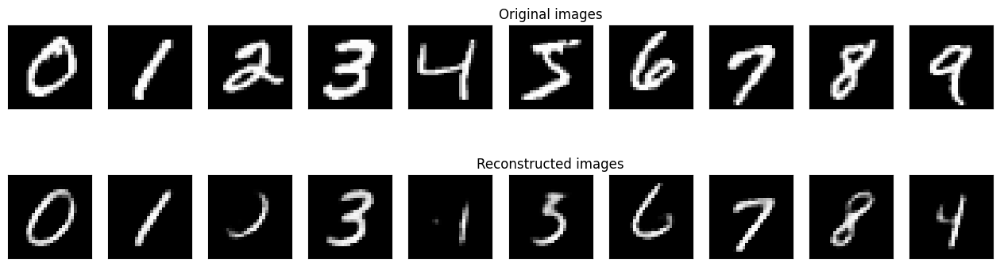

	 partial train loss (single batch): 22346.720703
	 partial train loss (single batch): 22563.462891
	 partial train loss (single batch): 22484.208984
	 partial train loss (single batch): 22384.611328
	 partial train loss (single batch): 22448.142578
	 partial train loss (single batch): 22495.802734
	 partial train loss (single batch): 22365.880859
	 partial train loss (single batch): 22283.943359
	 partial train loss (single batch): 22341.966797
	 partial train loss (single batch): 22277.130859
	 partial train loss (single batch): 22344.843750
	 partial train loss (single batch): 22448.792969
	 partial train loss (single batch): 22370.757812
	 partial train loss (single batch): 22361.501953
	 partial train loss (single batch): 22429.480469
	 partial train loss (single batch): 22115.910156
	 partial train loss (single batch): 22676.353516
	 partial train loss (single batch): 22265.466797
	 partial train loss (single batch): 22367.724609
	 partial train loss (single batch): 22042.414062


<Figure size 640x480 with 0 Axes>

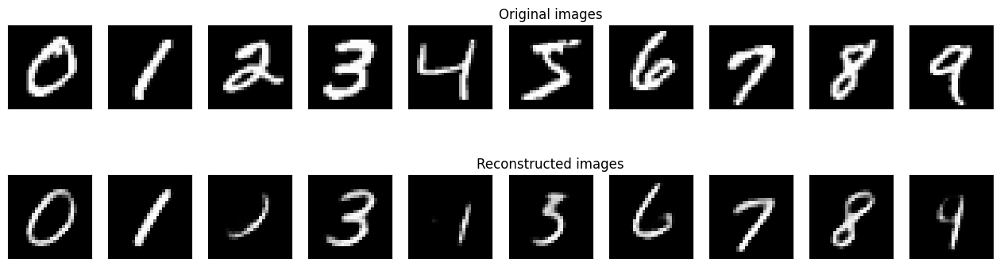

	 partial train loss (single batch): 22362.162109
	 partial train loss (single batch): 22547.218750
	 partial train loss (single batch): 22469.425781
	 partial train loss (single batch): 22364.960938
	 partial train loss (single batch): 22420.083984
	 partial train loss (single batch): 22483.195312
	 partial train loss (single batch): 22392.664062
	 partial train loss (single batch): 22292.615234
	 partial train loss (single batch): 22301.185547
	 partial train loss (single batch): 22255.970703
	 partial train loss (single batch): 22336.265625
	 partial train loss (single batch): 22450.046875
	 partial train loss (single batch): 22333.314453
	 partial train loss (single batch): 22367.191406
	 partial train loss (single batch): 22388.230469
	 partial train loss (single batch): 22116.693359
	 partial train loss (single batch): 22655.380859
	 partial train loss (single batch): 22267.447266
	 partial train loss (single batch): 22374.296875
	 partial train loss (single batch): 22055.650391


<Figure size 640x480 with 0 Axes>

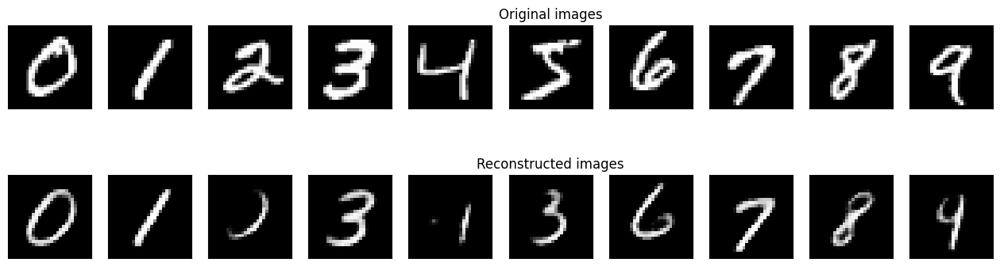

	 partial train loss (single batch): 22353.388672
	 partial train loss (single batch): 22578.451172
	 partial train loss (single batch): 22433.062500
	 partial train loss (single batch): 22387.093750
	 partial train loss (single batch): 22411.816406
	 partial train loss (single batch): 22471.529297
	 partial train loss (single batch): 22368.007812
	 partial train loss (single batch): 22277.117188
	 partial train loss (single batch): 22323.253906
	 partial train loss (single batch): 22264.488281
	 partial train loss (single batch): 22309.441406
	 partial train loss (single batch): 22429.550781
	 partial train loss (single batch): 22384.695312
	 partial train loss (single batch): 22378.136719
	 partial train loss (single batch): 22409.687500
	 partial train loss (single batch): 22120.074219
	 partial train loss (single batch): 22670.500000
	 partial train loss (single batch): 22212.226562
	 partial train loss (single batch): 22402.544922
	 partial train loss (single batch): 22067.375000


<Figure size 640x480 with 0 Axes>

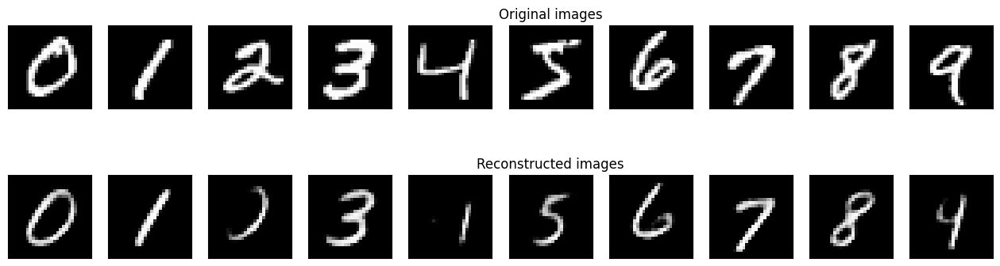

	 partial train loss (single batch): 22387.984375
	 partial train loss (single batch): 22562.023438
	 partial train loss (single batch): 22523.128906
	 partial train loss (single batch): 22382.453125
	 partial train loss (single batch): 22412.568359
	 partial train loss (single batch): 22480.697266
	 partial train loss (single batch): 22391.726562
	 partial train loss (single batch): 22286.210938
	 partial train loss (single batch): 22361.197266
	 partial train loss (single batch): 22239.615234
	 partial train loss (single batch): 22320.279297
	 partial train loss (single batch): 22415.125000
	 partial train loss (single batch): 22353.335938
	 partial train loss (single batch): 22355.484375
	 partial train loss (single batch): 22385.824219
	 partial train loss (single batch): 22089.060547
	 partial train loss (single batch): 22657.412109
	 partial train loss (single batch): 22274.541016
	 partial train loss (single batch): 22402.935547
	 partial train loss (single batch): 22057.865234


<Figure size 640x480 with 0 Axes>

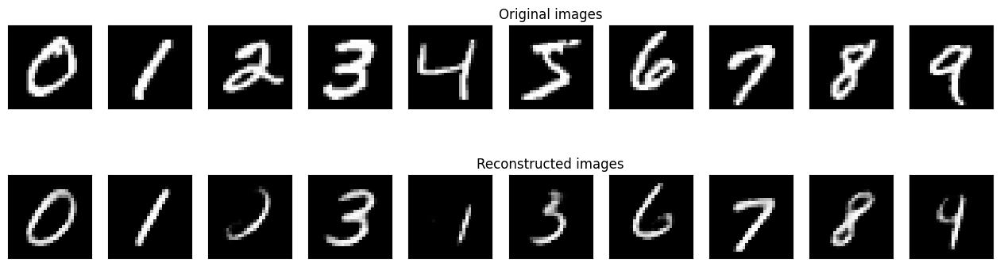

	 partial train loss (single batch): 22336.253906
	 partial train loss (single batch): 22550.218750
	 partial train loss (single batch): 22467.458984
	 partial train loss (single batch): 22335.257812
	 partial train loss (single batch): 22440.873047
	 partial train loss (single batch): 22491.703125
	 partial train loss (single batch): 22385.513672
	 partial train loss (single batch): 22316.300781
	 partial train loss (single batch): 22348.324219
	 partial train loss (single batch): 22249.658203
	 partial train loss (single batch): 22324.802734
	 partial train loss (single batch): 22441.912109
	 partial train loss (single batch): 22346.554688
	 partial train loss (single batch): 22364.710938
	 partial train loss (single batch): 22400.914062
	 partial train loss (single batch): 22086.501953
	 partial train loss (single batch): 22688.041016
	 partial train loss (single batch): 22237.445312
	 partial train loss (single batch): 22422.884766
	 partial train loss (single batch): 22052.628906


<Figure size 640x480 with 0 Axes>

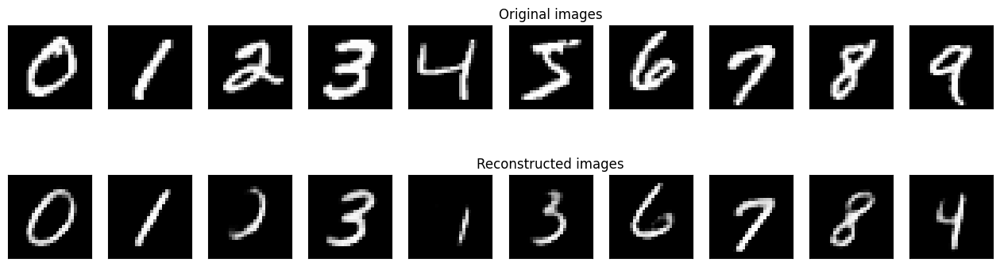

	 partial train loss (single batch): 22346.974609
	 partial train loss (single batch): 22554.283203
	 partial train loss (single batch): 22481.763672
	 partial train loss (single batch): 22388.216797
	 partial train loss (single batch): 22433.816406
	 partial train loss (single batch): 22499.417969
	 partial train loss (single batch): 22410.902344
	 partial train loss (single batch): 22351.035156
	 partial train loss (single batch): 22308.548828
	 partial train loss (single batch): 22234.716797
	 partial train loss (single batch): 22329.746094
	 partial train loss (single batch): 22448.396484
	 partial train loss (single batch): 22376.261719
	 partial train loss (single batch): 22357.332031
	 partial train loss (single batch): 22395.595703
	 partial train loss (single batch): 22141.570312
	 partial train loss (single batch): 22662.453125
	 partial train loss (single batch): 22278.556641
	 partial train loss (single batch): 22407.031250
	 partial train loss (single batch): 22066.417969


<Figure size 640x480 with 0 Axes>

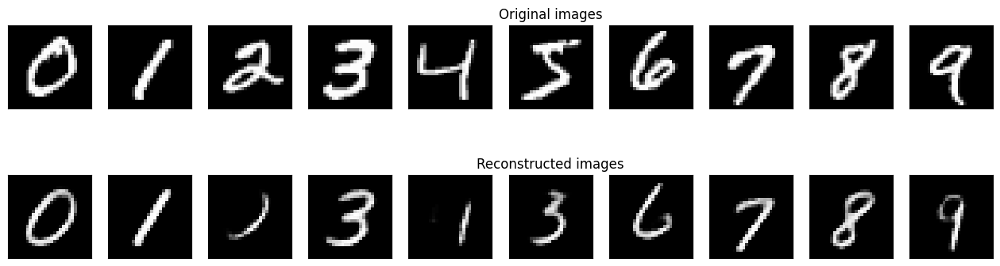

<Figure size 640x480 with 0 Axes>

In [24]:

num_epochs = 100
loss_train = []
loss_val = []

for epoch in range(num_epochs):
   train_loss = train_epoch(vae,device,train_loader,optim)
   val_loss = test_epoch(vae,device,valid_loader)
   print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   loss_train += train_loss
   loss_val = val_loss
   plot_ae_outputs(vae.encoder,vae.decoder,n=10)

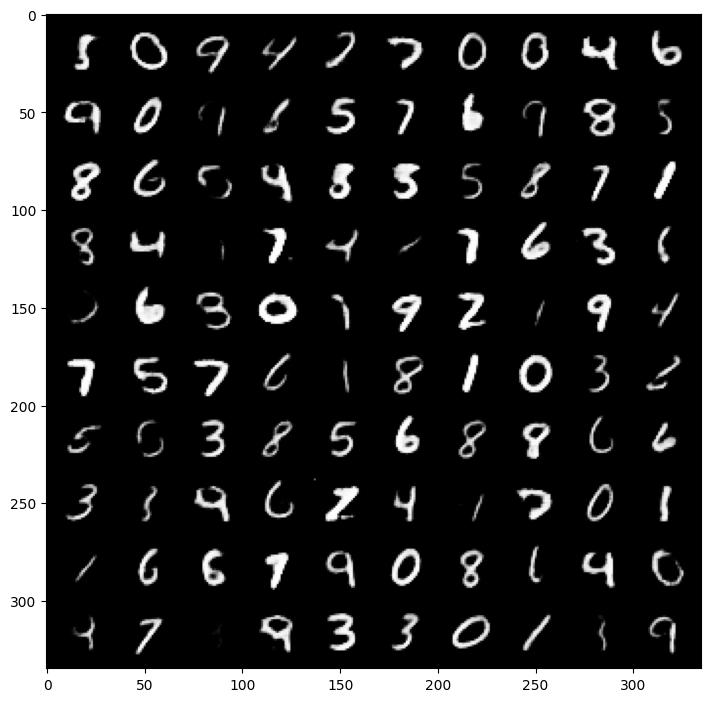

In [25]:
def show_image(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))


vae.eval()

with torch.no_grad():

    # sample latent vectors from the normal distribution
    latent = torch.randn(128, d, device=device)

    # reconstruct images from the latent vectors
    img_recon = vae.decoder(latent)
    img_recon = img_recon.cpu()

    fig, ax = plt.subplots(figsize=(20, 8.5))
    show_image(torchvision.utils.make_grid(img_recon.data[:100],10,5))
    plt.show()

In [26]:
from tqdm import tqdm
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    # Encode image
    vae.eval()
    with torch.no_grad():
        encoded_img  = vae.encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)
    
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples


from sklearn.manifold import TSNE
import plotly.express as px

px.scatter(encoded_samples, x='Enc. Variable 0', y='Enc. Variable 1', color=encoded_samples.label.astype(str), opacity=0.7)

100%|█████████████████████████████████████| 60000/60000 [10:14<00:00, 97.56it/s]


In [27]:
tsne = TSNE(n_components=2)
tsne_results = tsne.fit_transform(encoded_samples.drop(['label'],axis=1))

fig = px.scatter(tsne_results, x=0, y=1, color=encoded_samples.label.astype(str),labels={'0': 'tsne-2d-one', '1': 'tsne-2d-two'})
fig.show()

In [ ]:
epochs = range(1,35)
plt.plot(epochs, loss_train, 'g', label='Training loss')
plt.plot(epochs, loss_val, 'b', label='validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()